In [4]:
import os, sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from importlib import reload
from tqdm import tqdm

In [5]:
NOTEBOOK_DIR = os.getcwd()
MODULE_DIR, _ = os.path.split(NOTEBOOK_DIR)
sys.path.append(MODULE_DIR)

In [6]:
from longterm import load, utils
from longterm import analysis as an
from longterm.behaviour import synchronisation as sync
from longterm import plot as myplt

In [7]:
fly_dirs = [os.path.join(load.NAS2_DIR_LH, "210512", "fly3"),
            os.path.join(load.NAS2_DIR_LH, "210519", "fly1"),
            os.path.join(load.NAS2_DIR_LH, "210521", "fly1"),
            os.path.join(load.NAS2_DIR_LH, "210526", "fly2"),
            os.path.join(load.NAS2_DIR_LH, "210527", "fly4"),
            os.path.join(load.NAS2_DIR_LH, "210602", "fly2"),
            os.path.join(load.NAS2_DIR_LH, "210603", "fly2")]
N_flies = len(fly_dirs)
all_i_trials = [[2,5,11],  # long version: [0,2,3,5,8,11]]
                [3,8,12],
                [3,7,12],
                [2,7,11],
                [3,6,10],
                [3,6,10],
                [1,6,10]]
conditions = ["12.5. water", "19.5. caff", "21.5. nofeed", "26.5. caff", "27.5. nofeed", " 2.6. sucr", "3.6. sucr"]

all_trial_dirs = [utils.readlines_tolist(os.path.join(fly_dir, "trial_dirs.txt")) 
                  for fly_dir in fly_dirs]
all_trial_dirs = [[all_trial_dirs[i_fly][i_trial] 
                   for i_trial in i_trials] 
                  for i_fly, i_trials in enumerate(all_i_trials)]

all_processed_dirs = [[os.path.join(trial_dir, load.PROCESSED_FOLDER) 
                       for trial_dir in trial_dirs] 
                      for trial_dirs in all_trial_dirs]
all_neural_df_dirs = [[os.path.join(processed_dir, "twop_df.pkl") 
                       for processed_dir in processed_dirs] 
                      for processed_dirs in all_processed_dirs]
all_neural_dfs = [[pd.read_pickle(neural_df_dir) for neural_df_dir in neural_df_dirs]
                  for neural_df_dirs in all_neural_df_dirs]
all_opflow_df_dirs = [[os.path.join(processed_dir, "opflow_df.pkl") for processed_dir in processed_dirs] 
                      for processed_dirs in all_processed_dirs]
all_opflow_dfs = [[pd.read_pickle(opflow_df_dir) for opflow_df_dir in opflow_df_dirs] 
                  for opflow_df_dirs in all_opflow_df_dirs]

In [8]:
def opflow_filter(x, sigma=80):
    return np.convolve(x, np.ones((sigma))/sigma, mode="same")

all_v_fs = [[opflow_df.velForw for opflow_df in opflow_dfs] for opflow_dfs in all_opflow_dfs]
all_v_ss = [[opflow_df.velSide for opflow_df in opflow_dfs] for opflow_dfs in all_opflow_dfs]
all_v_ts = [[opflow_df.velTurn for opflow_df in opflow_dfs] for opflow_dfs in all_opflow_dfs]

In [9]:
all_v_f_reds = [[sync.reduce_during_2p_frame(twop_index=opflow_df.twop_index, 
                                             values=np.expand_dims(v_f, axis=1))[:-1].squeeze() 
                 for opflow_df, v_f in zip(opflow_dfs, v_fs)] 
                for opflow_dfs, v_fs in zip(all_opflow_dfs, all_v_fs)]
all_v_s_reds = [[sync.reduce_during_2p_frame(twop_index=opflow_df.twop_index, 
                                             values=np.expand_dims(v_s, axis=1))[:-1].squeeze() 
                 for opflow_df, v_s in zip(opflow_dfs, v_ss)] 
                for opflow_dfs, v_ss in zip(all_opflow_dfs, all_v_ss)]
all_v_t_reds = [[sync.reduce_during_2p_frame(twop_index=opflow_df.twop_index, 
                                             values=np.expand_dims(v_t, axis=1))[:-1].squeeze() 
                 for opflow_df, v_t in zip(opflow_dfs, v_ts)] 
                for opflow_dfs, v_ts in zip(all_opflow_dfs, all_v_ts)]

In [22]:
thres_rest = [0.01, 0.015, 0.01, 0.01, 0.015, 0.015, 0.015]
thres_walk = [0.035, 0.03, 0.025, 0.02, 0.03, 0.04, 0.04]
all_rest_reds = [[np.logical_and.reduce((np.abs(v_f_red) <= t_rest, np.abs(v_s_red) <= t_rest, np.abs(v_t_red) <= t_rest)) 
                  for v_f_red, v_s_red, v_t_red, t_rest in zip(v_f_reds, v_s_reds, v_t_reds, thres_rest)]
                 for v_f_reds, v_s_reds, v_t_reds in zip(all_v_f_reds, all_v_s_reds, all_v_t_reds)]
all_rest_strict_reds = [[np.logical_and(np.convolve(rest_red, np.ones(16)/16, mode="same") >= 0.75, rest_red) 
                         for rest_red in rest_reds] 
                        for rest_reds in all_rest_reds]
all_walk_reds = [[v_f_red >= t_walk for v_f_red, t_walk in zip(v_f_reds, thres_walk)] 
                 for v_f_reds in all_v_f_reds]
all_walk_strict_reds = [[np.logical_and(np.convolve(walk_red, np.ones(4)/4, mode="same") >= 0.75, walk_red) 
                         for walk_red in walk_reds] 
                        for walk_reds in all_walk_reds]

<IPython.core.display.Javascript object>


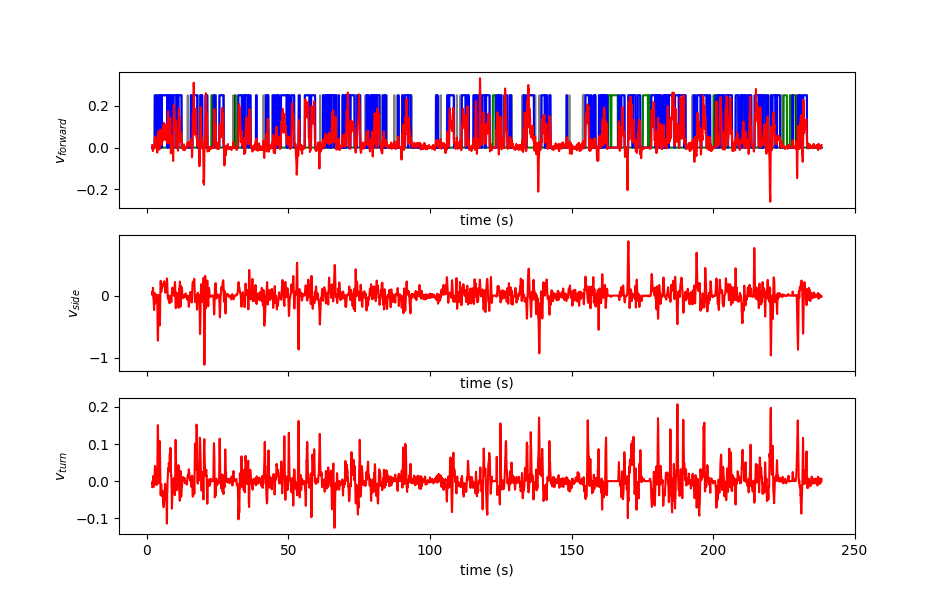

Text(0, 0.5, '$v_{turn}$')

In [21]:
%matplotlib notebook

i_fly = 6
i_trial = 2
t = all_neural_dfs[i_fly][i_trial].t
factor = 0.25

fig, axs = plt.subplots(3,1,figsize=(9.5,6), sharex=True)  # , sharey=True)
# axs[0].plot(t, all_rest_reds[i_fly][i_trial]*factor,'k', alpha=0.5)
axs[0].plot(t, all_rest_strict_reds[i_fly][i_trial]*factor,'g')
axs[0].plot(t, all_walk_reds[i_fly][i_trial]*factor,'k', alpha=0.5)
axs[0].plot(t, all_walk_strict_reds[i_fly][i_trial]*factor,'b')
axs[0].plot(t, all_v_f_reds[i_fly][i_trial],'r')
axs[0].set_xlabel("time (s)")
axs[0].set_ylabel("$v_{forward}$")

axs[1].plot(t, all_v_t_reds[i_fly][i_trial],'r')
axs[1].set_xlabel("time (s)")
axs[1].set_ylabel("$v_{side}$")

axs[2].plot(t, all_v_s_reds[i_fly][i_trial],'r')
axs[2].set_xlabel("time (s)")
axs[2].set_ylabel("$v_{turn}$")

# axs[2].set_xlim(0,100)

In [10]:
all_walk_strict_reds[3][0][2186:2188] = 1

In [23]:
print("Walking")
[print([np.mean(walk_strict_red) for walk_strict_red in walk_strict_reds]) for walk_strict_reds in all_walk_strict_reds]
print("Resting")
[print([np.mean(rest_strict_red) for rest_strict_red in rest_strict_reds]) for rest_strict_reds in all_rest_strict_reds]

Walking
[0.11770833333333333, 0.40390625, 0.2799479166666667]
[0.15546875, 0.11276041666666667, 0.196875]
[0.005729166666666666, 0.005729166666666666, 0.1765625]
[0.0005208333333333333, 0.0859375, 0.20572916666666666]
[0.0921875, 0.13411458333333334, 0.32083333333333336]
[0.184375, 0.17708333333333334, 0.48984375]
[0.17890625, 0.2328125, 0.3984375]
Resting
[0.3731770833333333, 0.21119791666666668, 0.3734375]
[0.35859375, 0.42135416666666664, 0.028645833333333332]
[0.90625, 0.9536458333333333, 0.4744791666666667]
[0.8671875, 0.18567708333333333, 0.09791666666666667]
[0.5200520833333333, 0.40182291666666664, 0.029166666666666667]
[0.16875, 0.25416666666666665, 0.01484375]
[0.22760416666666666, 0.1796875, 0.04453125]


[None, None, None, None, None, None, None]

In [12]:
all_neurons = [[neural_df.filter(regex="neuron").to_numpy() for neural_df in neural_dfs] for neural_dfs in all_neural_dfs]
all_neurons_mean = [np.concatenate(neurons).mean(axis=0) for neurons in all_neurons]
all_neurons_std = [np.concatenate(neurons).std(axis=0) for neurons in all_neurons]
all_neurons = [[(neuron - neurons_mean) / neurons_std for neuron in neurons] 
               for neurons, neurons_mean, neurons_std in zip(all_neurons, all_neurons_mean, all_neurons_std)]
all_cov_neurons = [an.cov(np.concatenate(neurons)) for neurons in all_neurons]
all_sort_idx = [an.cluster_corr(cov_neurons) for cov_neurons in all_cov_neurons]
all_neurons = [[neuron[:,sort_idx] for neuron in neurons] for neurons, sort_idx in zip(all_neurons, all_sort_idx)]

In [13]:
all_neurons_walk = [[neuron[walk_strict_red, :] 
                     for neuron, walk_strict_red in zip(neurons, walk_strict_reds)] 
                    for neurons, walk_strict_reds in zip(all_neurons, all_walk_strict_reds)]
all_neurons_rest = [[neuron[rest_strict_red, :]
                     for neuron, rest_strict_red in zip(neurons, rest_strict_reds)]
                    for neurons, rest_strict_reds in zip(all_neurons, all_rest_strict_reds)]

In [14]:
all_cov_X = []
all_cov_X_walk = []
all_cov_X_rest = []
all_cov_X_intra = []
all_cov_X_inter = []
for i_fly, (neurons_walk, neurons_rest) in enumerate(zip(all_neurons_walk, all_neurons_rest)):
    cov_X, cov_X_walk, cov_X_rest, cov_X_intra, cov_X_inter = an.cov_pair(np.concatenate(neurons_walk), np.concatenate(neurons_rest))
    all_cov_X.append(cov_X)
    all_cov_X_walk.append(cov_X_walk)
    all_cov_X_rest.append(cov_X_rest)
    all_cov_X_intra.append(cov_X_intra)
    all_cov_X_inter.append(cov_X_inter)

<IPython.core.display.Javascript object>


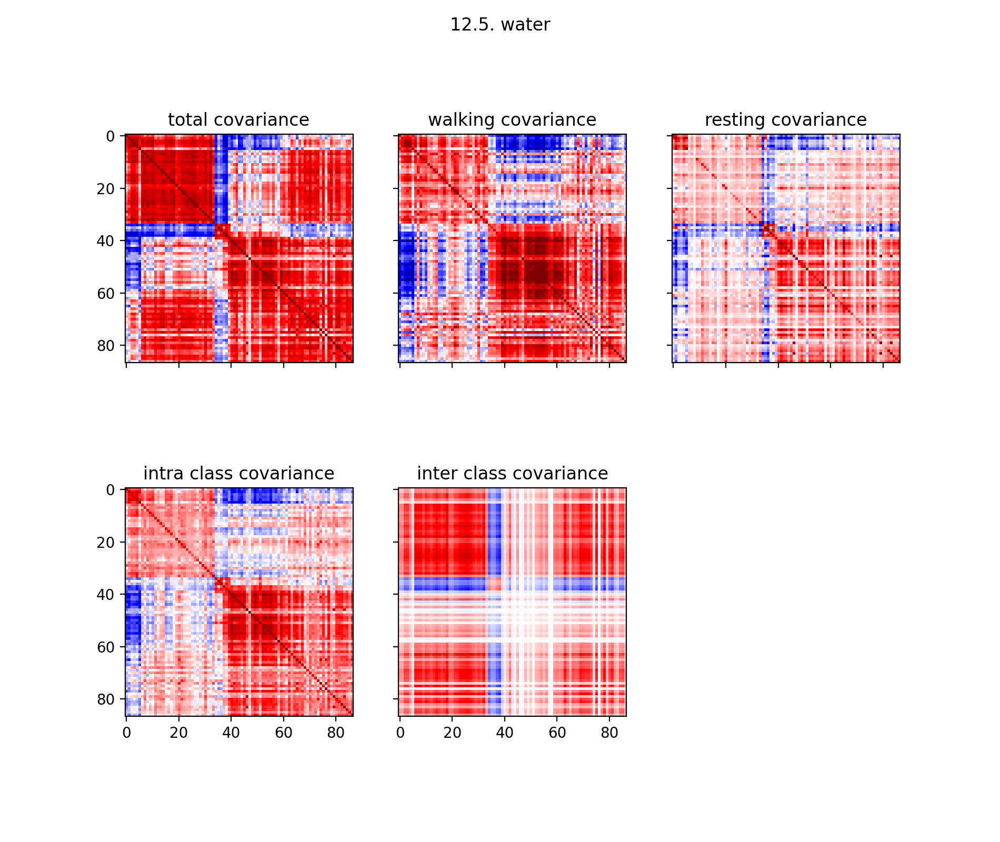

<IPython.core.display.Javascript object>


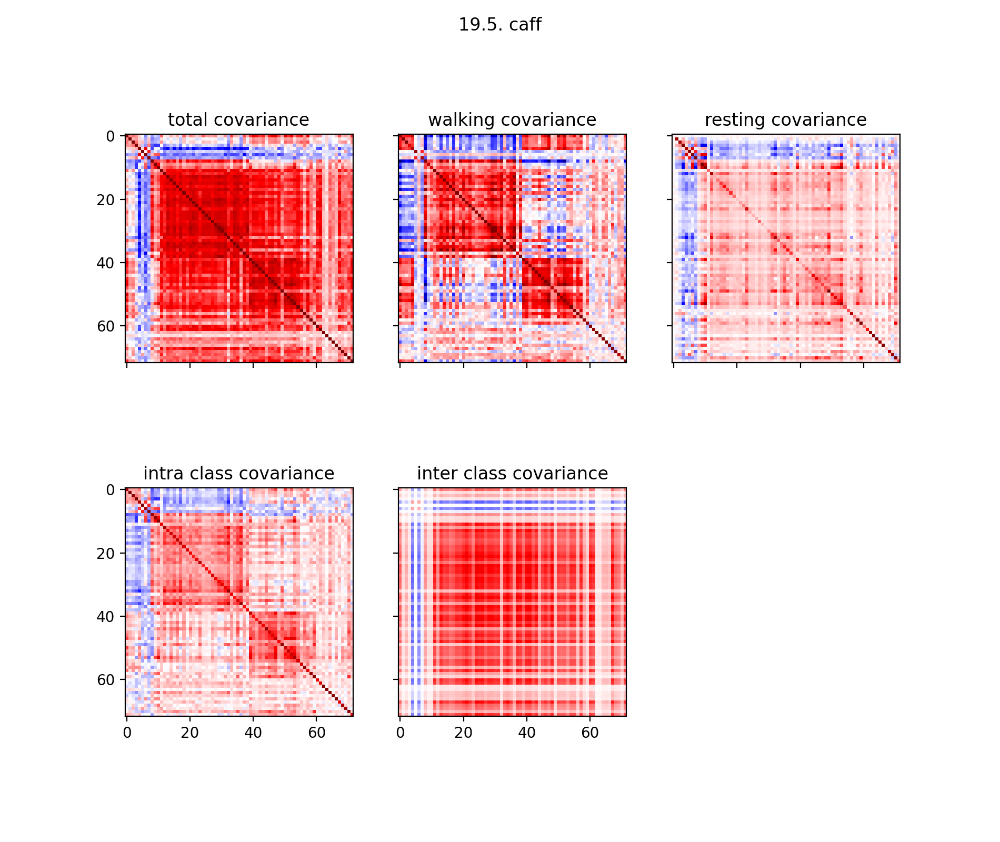

<IPython.core.display.Javascript object>


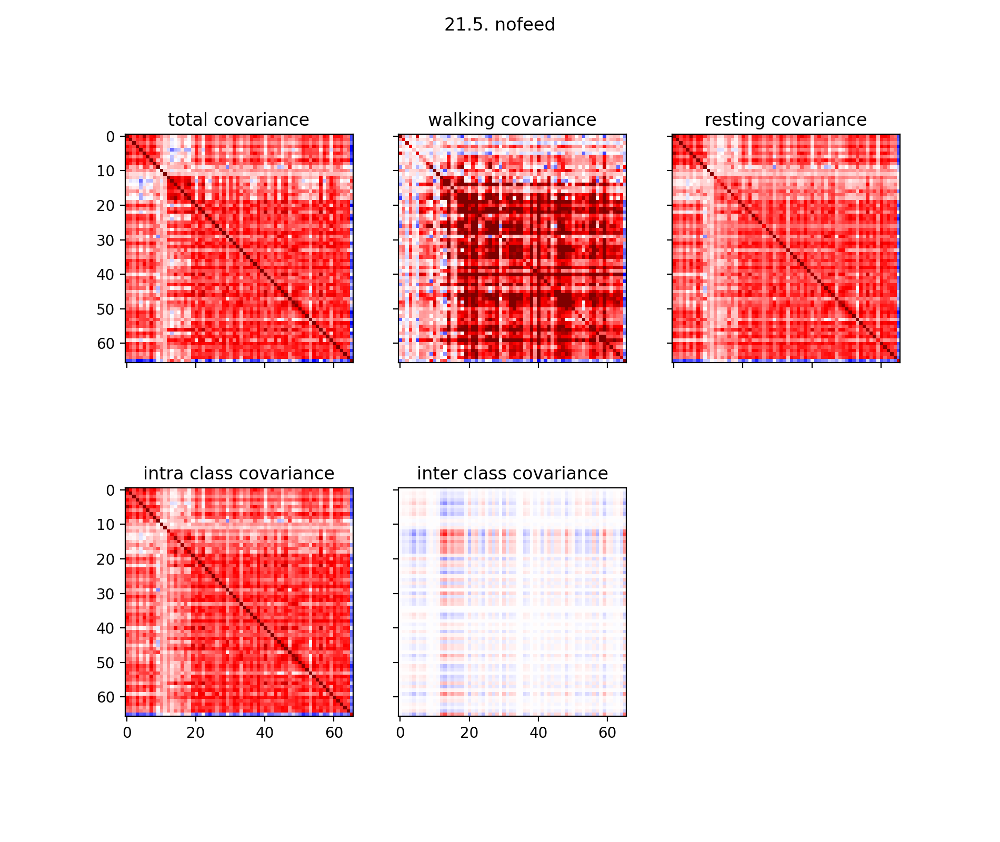

<IPython.core.display.Javascript object>


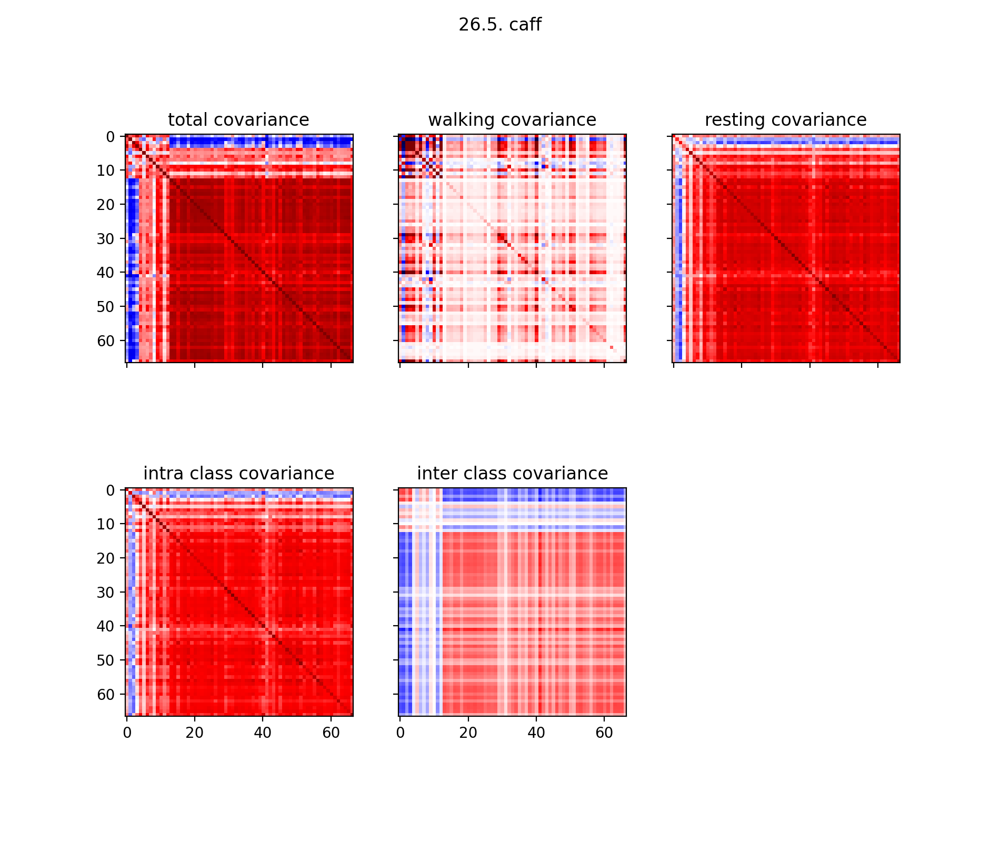

<IPython.core.display.Javascript object>


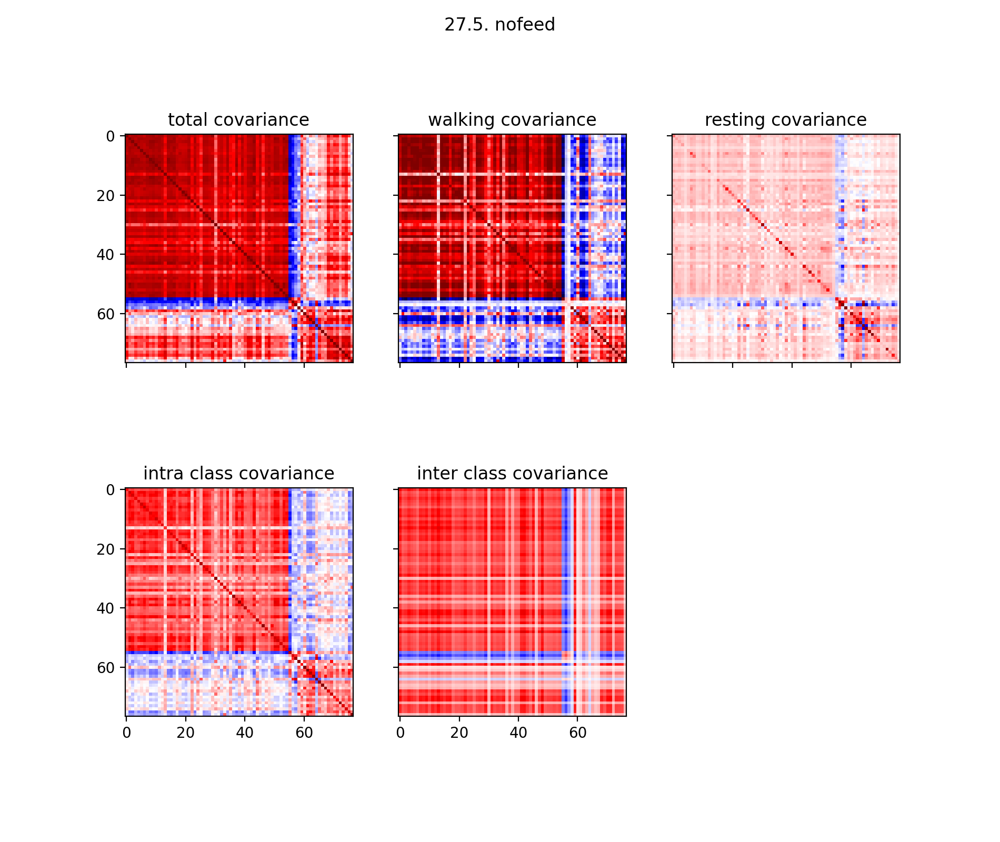

In [15]:
%matplotlib notebook

for i_fly in range(N_flies):
    cov_X = all_cov_X[i_fly]
    cov_X_walk = all_cov_X_walk[i_fly]
    cov_X_rest = all_cov_X_rest[i_fly]
    cov_X_intra = all_cov_X_intra[i_fly]
    cov_X_inter = all_cov_X_inter[i_fly]

    fig, axs = plt.subplots(2,3,figsize=(9.5, 8), sharex=True, sharey=True)
    clim = [np.quantile(cov_X, 0.01), np.quantile(cov_X, 0.99)]
    clim = [-1,1]
    axs[0,0].imshow(cov_X, clim=clim, cmap=plt.cm.get_cmap("seismic"))
    axs[0,0].set_title("total covariance")
    axs[0,1].imshow(cov_X_walk, clim=clim, cmap=plt.cm.get_cmap("seismic"))
    axs[0,1].set_title("walking covariance")
    axs[0,2].imshow(cov_X_rest, clim=clim, cmap=plt.cm.get_cmap("seismic"))
    axs[0,2].set_title("resting covariance")
    axs[1,0].imshow(cov_X_intra, clim=clim, cmap=plt.cm.get_cmap("seismic"))
    axs[1,0].set_title("intra class covariance")
    axs[1,1].imshow(cov_X_inter, clim=clim, cmap=plt.cm.get_cmap("seismic"))
    axs[1,1].set_title("inter class covariance")
    axs[1,2].axis("off")
    fig.suptitle(conditions[i_fly])

In [16]:
all_w_inter_pca = [an.inter_condition_pca(np.concatenate(neurons_walk), np.concatenate(neurons_rest)) 
                  for neurons_walk, neurons_rest in zip(all_neurons_walk, all_neurons_rest)]
all_w_inter_lda = [an.inter_condition_lda(np.concatenate(neurons_walk), np.concatenate(neurons_rest)) 
                  for neurons_walk, neurons_rest in zip(all_neurons_walk, all_neurons_rest)]
all_w_pca = [an.pca(np.concatenate(neurons), n=1).squeeze() 
            for neurons in all_neurons_rest]

In [17]:
all_X_proj_walk_inter_pca = [np.concatenate(neurons_walk).dot(w_inter_pca) 
                            for neurons_walk, w_inter_pca in zip(all_neurons_walk, all_w_inter_pca)]
all_X_proj_rest_inter_pca = [np.concatenate(neurons_rest).dot(w_inter_pca) 
                            for neurons_rest, w_inter_pca in zip(all_neurons_rest, all_w_inter_pca)]
all_X_proj_walk_inter_lda = [np.concatenate(neurons_walk).dot(w_inter_lda) 
                            for neurons_walk, w_inter_lda in zip(all_neurons_walk, all_w_inter_lda)]
all_X_proj_rest_inter_lda = [np.concatenate(neurons_rest).dot(w_inter_lda) 
                            for neurons_rest, w_inter_lda in zip(all_neurons_rest, all_w_inter_lda)]
all_X_proj_walk_pca = [np.concatenate(neurons_walk).dot(w_pca) 
                            for neurons_walk, w_pca in zip(all_neurons_walk, all_w_pca)]
all_X_proj_rest_pca = [np.concatenate(neurons_rest).dot(w_pca) 
                            for neurons_rest, w_pca in zip(all_neurons_rest, all_w_pca)]

<IPython.core.display.Javascript object>


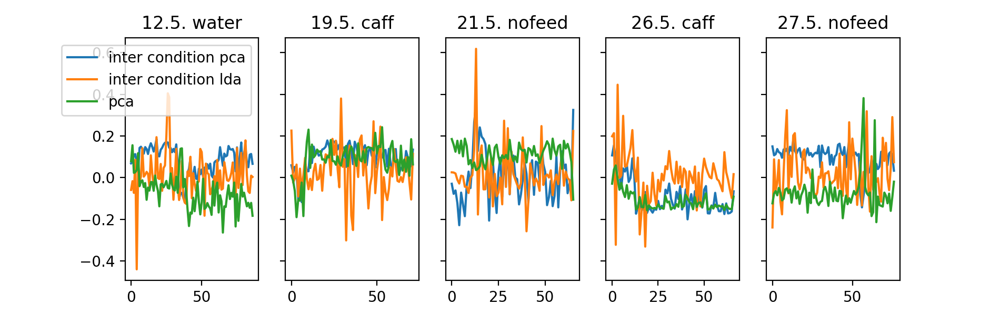

In [18]:
%matplotlib notebook
fig, axs = plt.subplots(1,N_flies, figsize=(9.5,3), sharey=True)
for i_ax, ax in enumerate(axs):
    ax.plot(all_w_inter_pca[i_ax], label="inter condition pca")
    ax.plot(all_w_inter_lda[i_ax], label="inter condition lda")
    ax.plot(all_w_pca[i_ax], label="pca")
    if i_ax == 0:
        ax.legend()
    ax.set_title(conditions[i_ax])

<IPython.core.display.Javascript object>


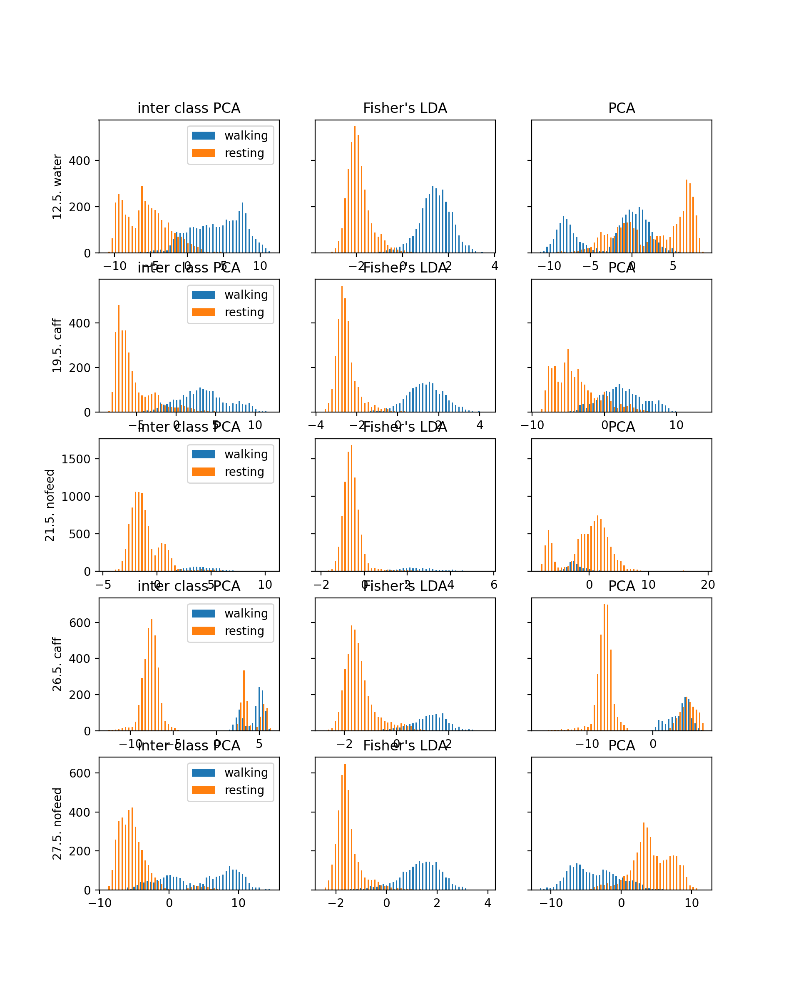

In [19]:
%matplotlib notebook
fig, axs = plt.subplots(N_flies,3, figsize=(9.5, 12), sharey="row")
for i_fly, axs_row in enumerate(axs):
    axs_row[0].hist([all_X_proj_walk_inter_pca[i_fly], all_X_proj_rest_inter_pca[i_fly]], bins=50, label=["walking", "resting"])
    axs_row[0].set_title("inter class PCA")
    axs_row[0].set_ylabel(conditions[i_fly])
    axs_row[0].legend()

    axs_row[1].hist([all_X_proj_walk_inter_lda[i_fly], all_X_proj_rest_inter_lda[i_fly]], bins=50, label=["walking", "resting"])
    axs_row[1].set_title("Fisher's LDA")

    axs_row[2].hist([all_X_proj_walk_pca[i_fly], all_X_proj_rest_pca[i_fly]], bins=50, label=["walking", "resting"])
    axs_row[2].set_title("PCA")




# comparison between flies

In [20]:
all_cov_matrix_walk = []
all_cov_total_walk = []
all_cov_intra_walk = []
all_cov_inter_walk = []
all_cov_matrix_rest = []
all_cov_total_rest = []
all_cov_intra_rest = []
all_cov_inter_rest = []
for i_fly, (neurons_walk, neurons_rest) in enumerate(zip(all_neurons_walk, all_neurons_rest)):
    cov_matrix_walk, cov_total_walk, cov_intra_walk, cov_inter_walk = an.all_cov_pairs(neurons_walk)
    all_cov_matrix_walk.append(cov_matrix_walk)
    all_cov_total_walk.append(cov_total_walk)
    all_cov_intra_walk.append(cov_intra_walk)
    all_cov_inter_walk.append(cov_inter_walk)
    cov_matrix_rest, cov_total_rest, cov_intra_rest, cov_inter_rest = an.all_cov_pairs(neurons_rest)
    all_cov_matrix_rest.append(cov_matrix_rest)
    all_cov_total_rest.append(cov_total_rest)
    all_cov_intra_rest.append(cov_intra_rest)
    all_cov_inter_rest.append(cov_inter_rest)

<IPython.core.display.Javascript object>


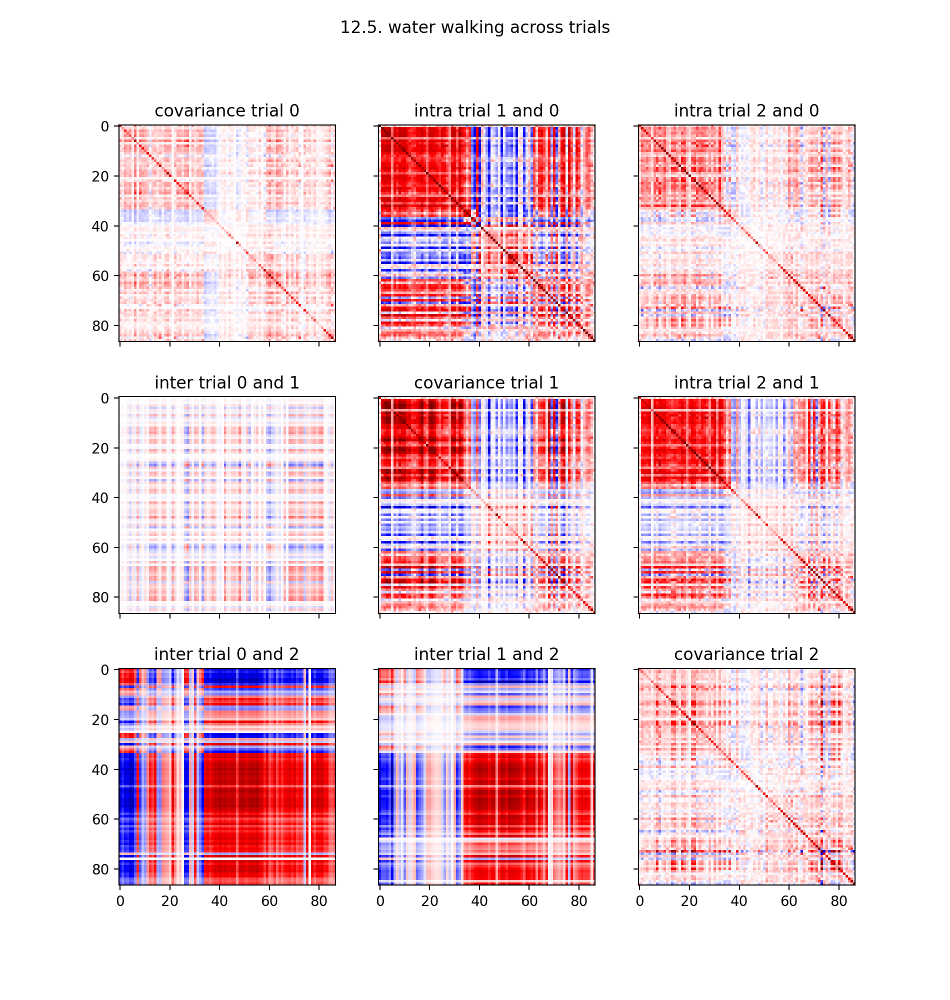

<IPython.core.display.Javascript object>


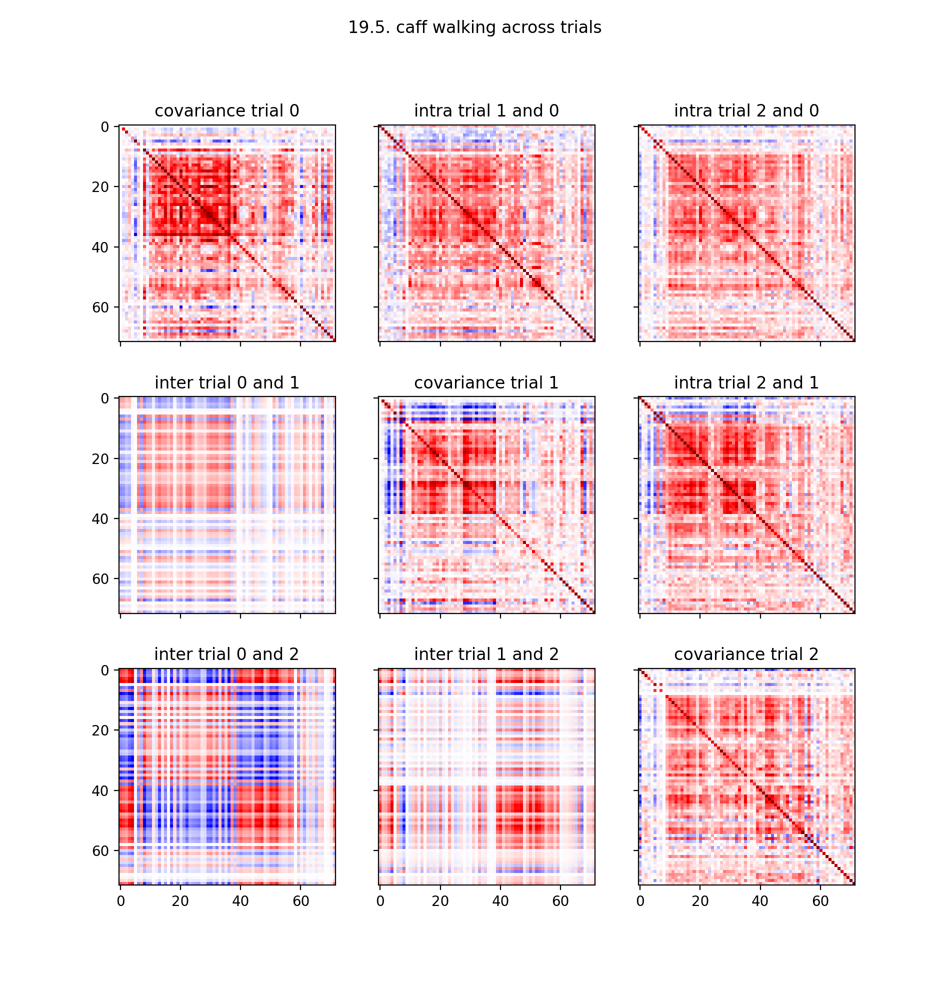

<IPython.core.display.Javascript object>


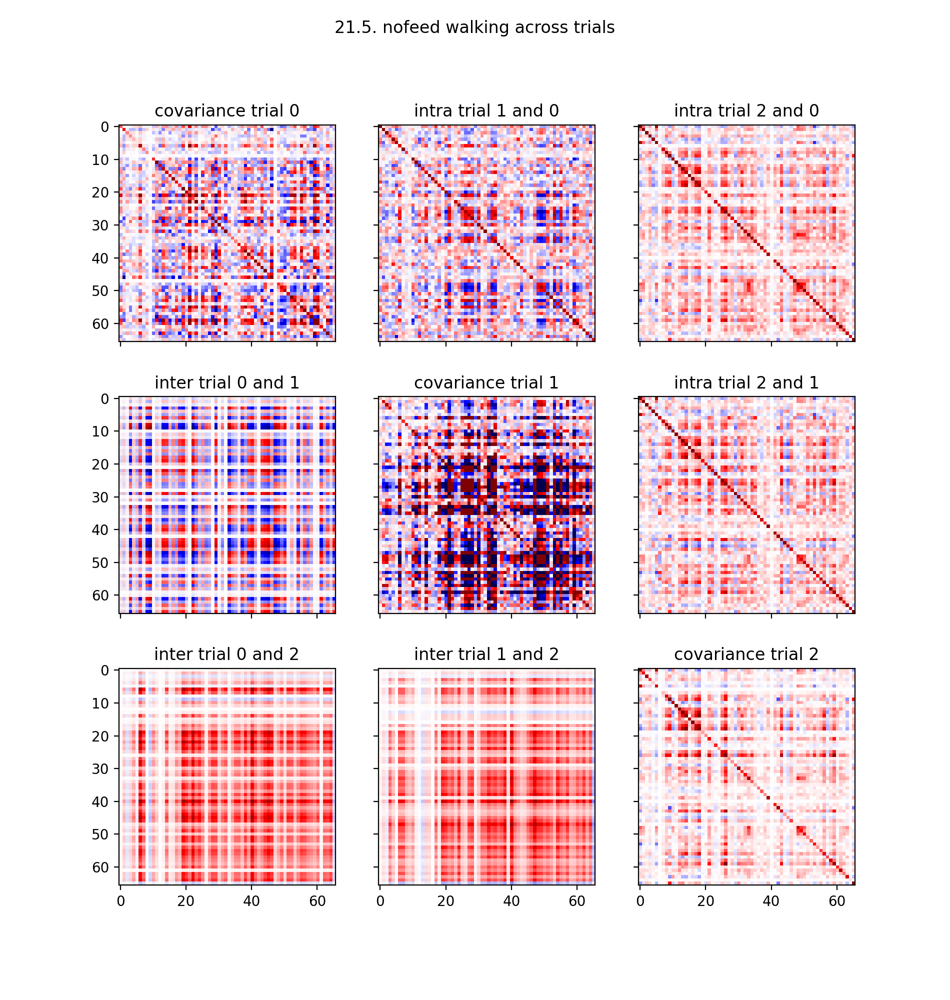

<IPython.core.display.Javascript object>


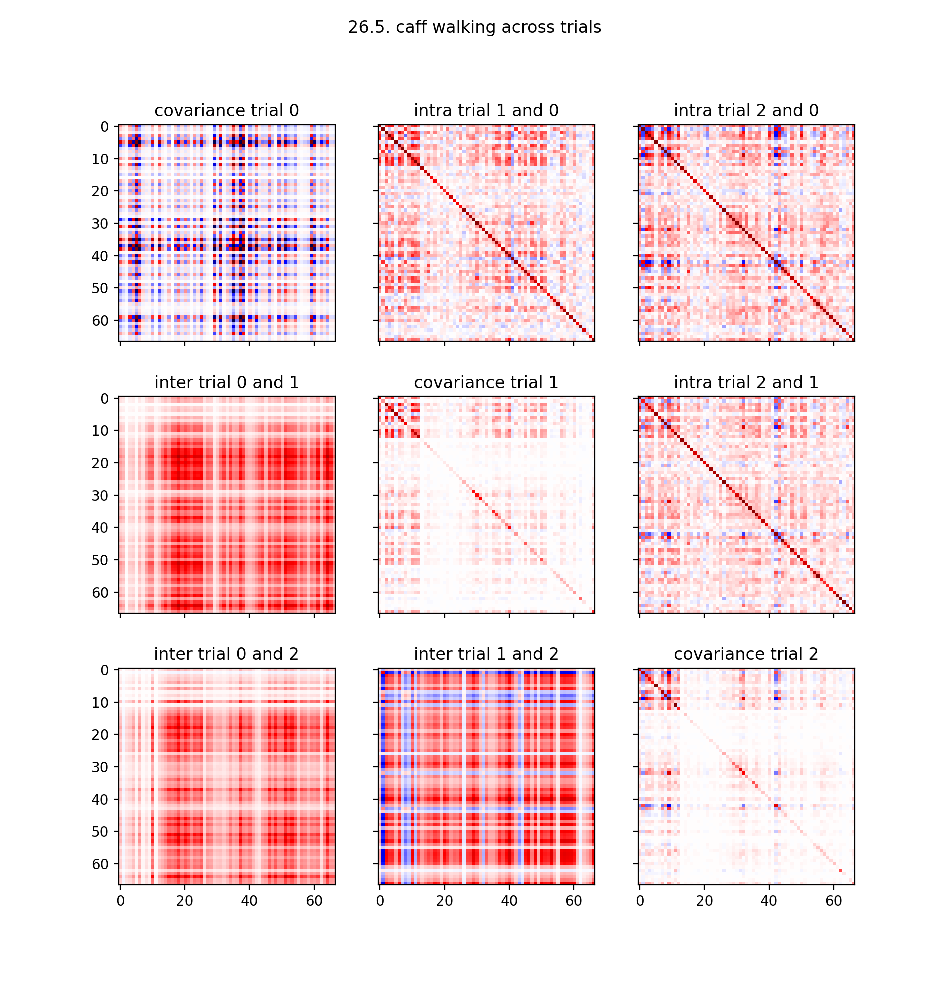

<IPython.core.display.Javascript object>


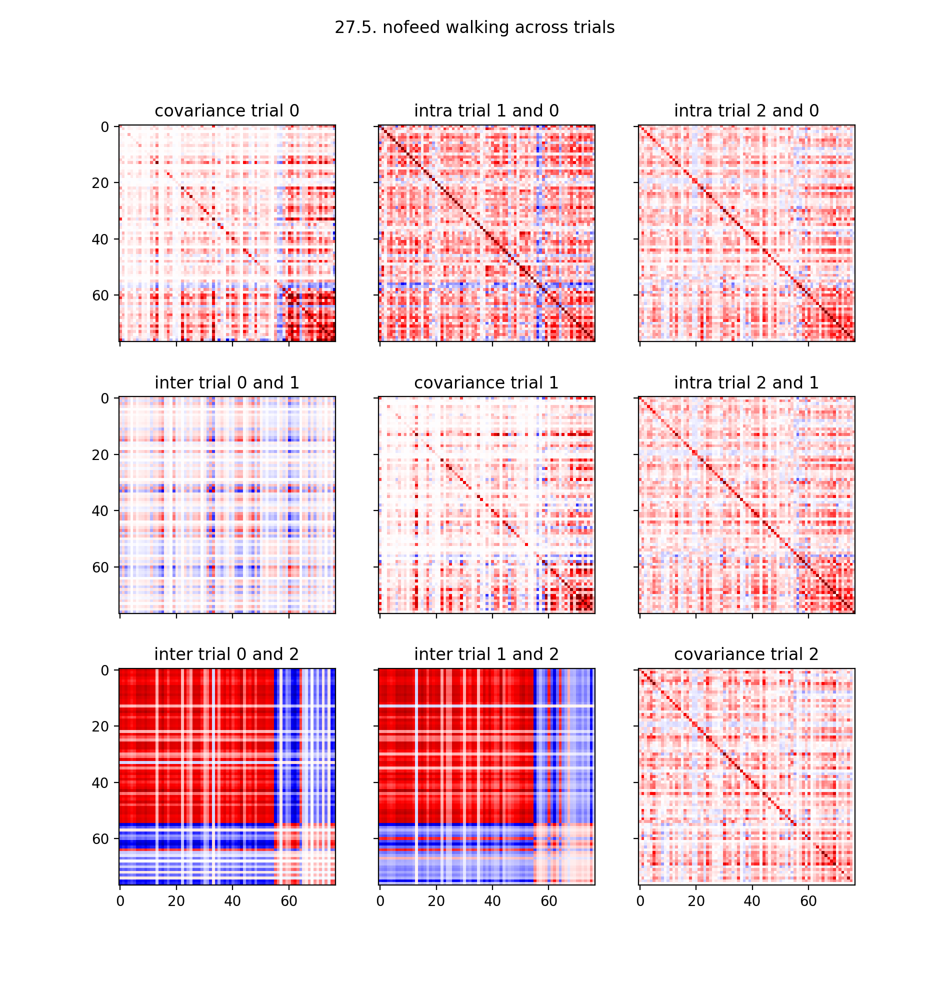

In [21]:
%matplotlib notebook
for i_fly in range(N_flies):
    an.plot_cov_matrix(all_cov_matrix_walk[i_fly], trials=[0,1,2], clim=[-1,1], name=conditions[i_fly]+" walking across trials")

<IPython.core.display.Javascript object>


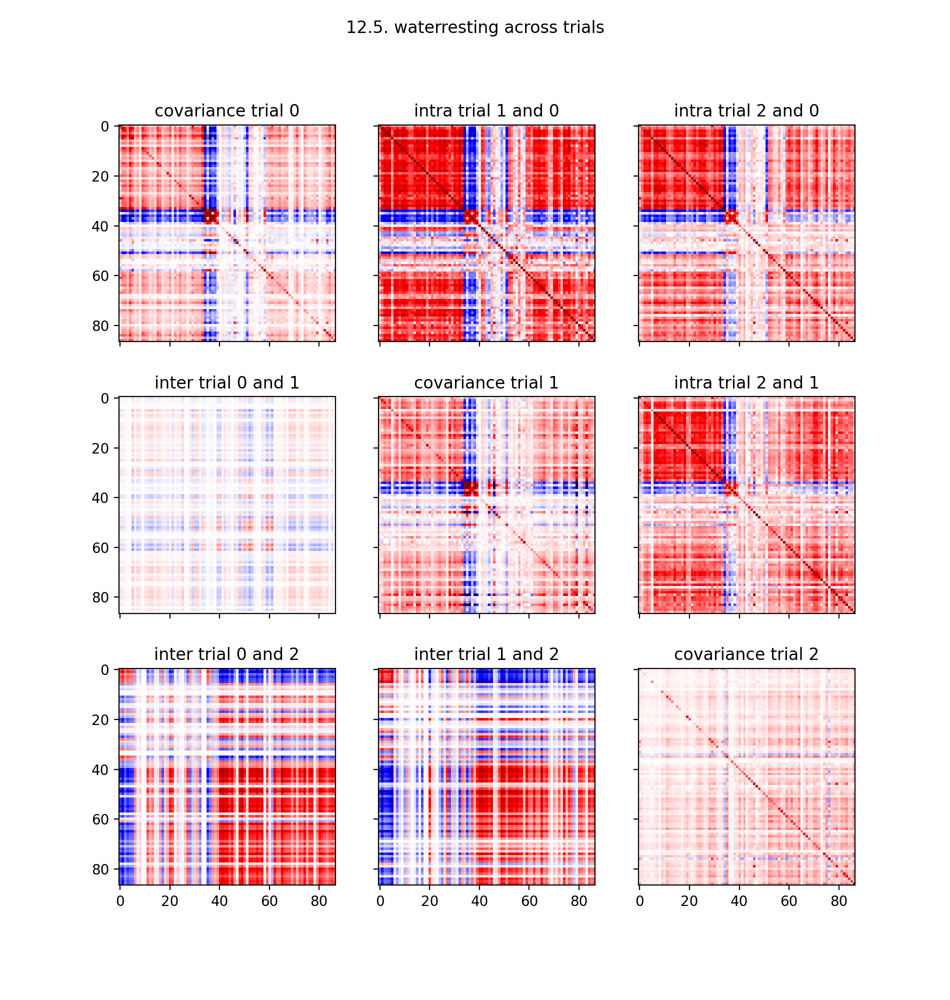

<IPython.core.display.Javascript object>


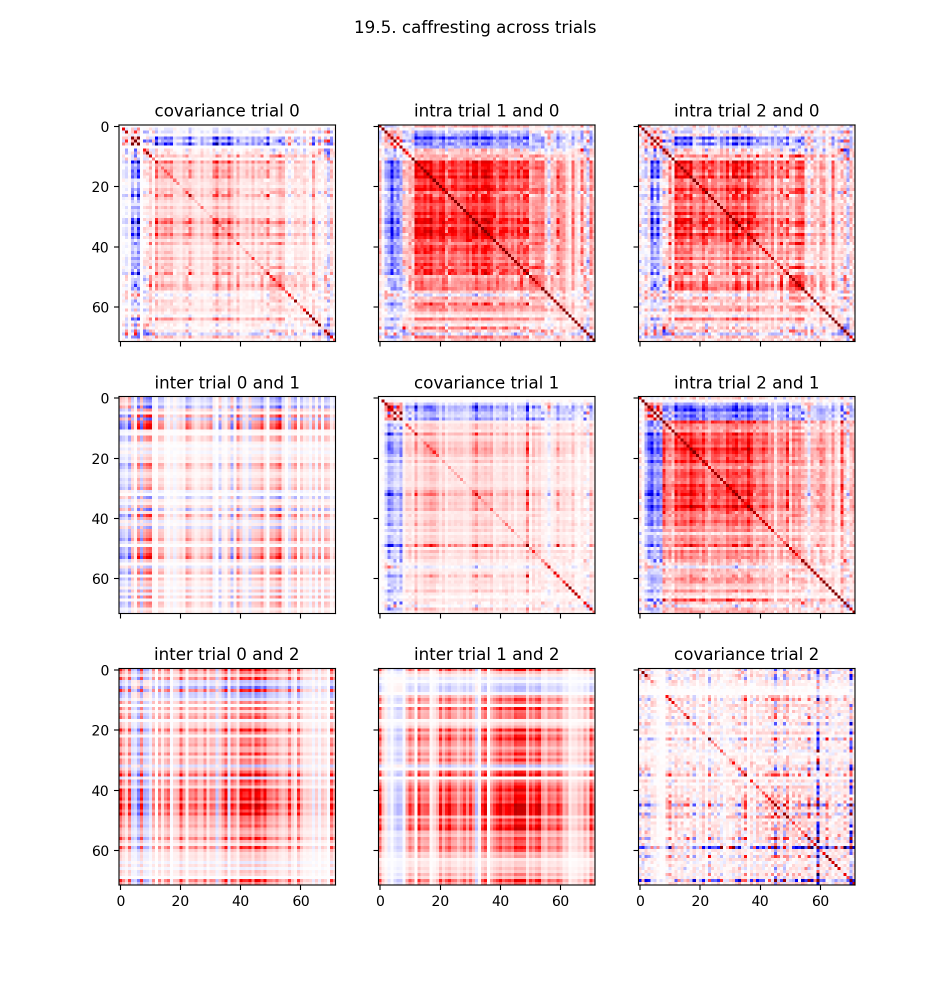

<IPython.core.display.Javascript object>


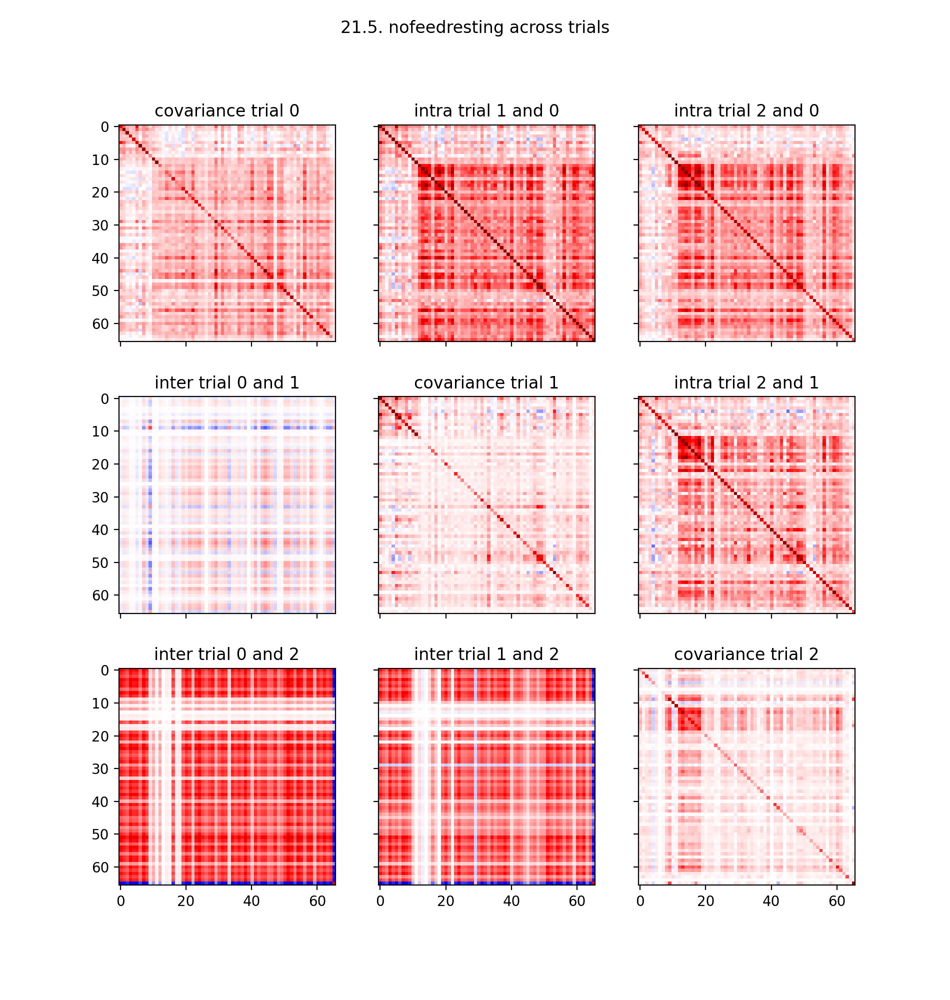

<IPython.core.display.Javascript object>


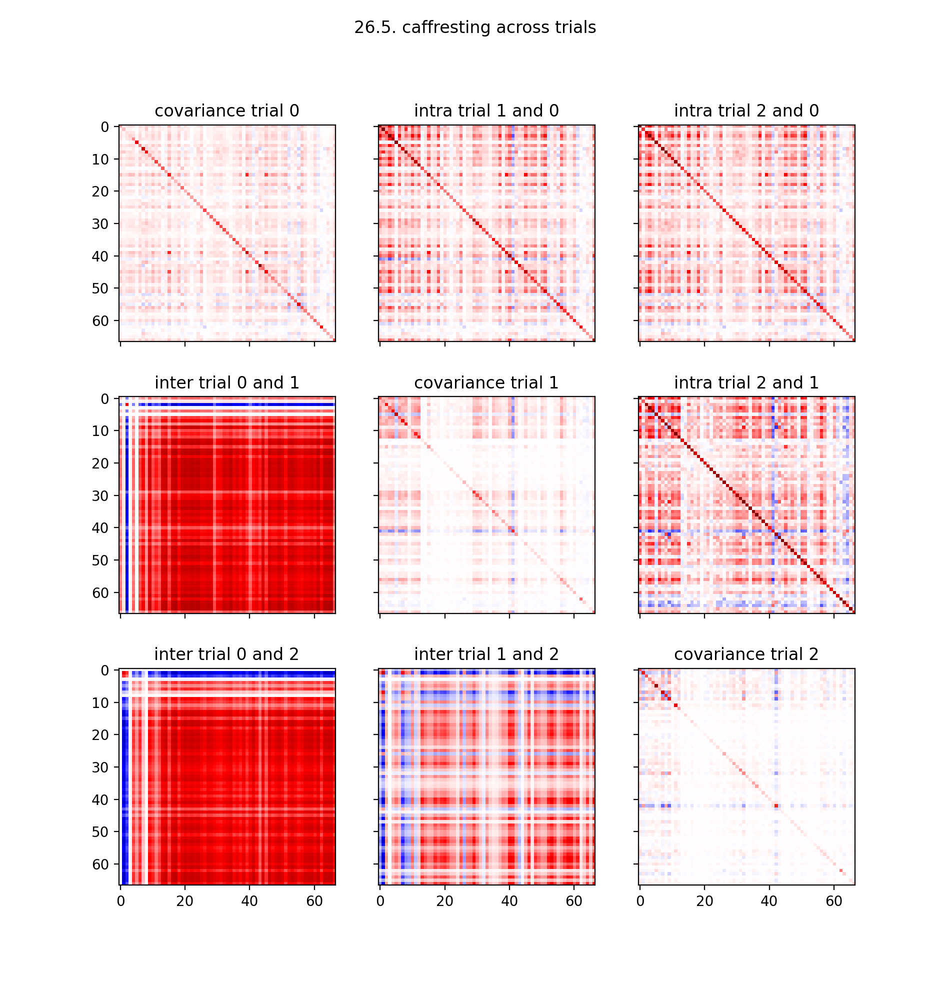

<IPython.core.display.Javascript object>


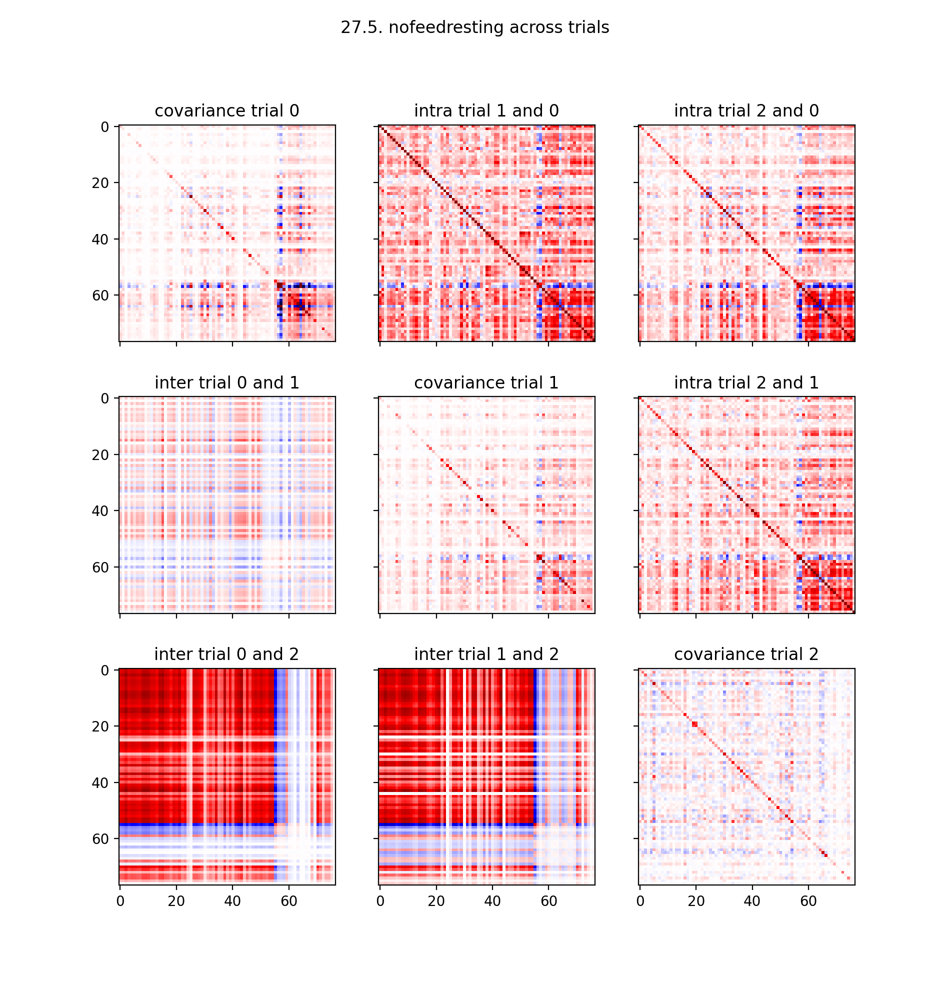

In [22]:
%matplotlib notebook
for i_fly in range(N_flies):
    an.plot_cov_matrix(all_cov_matrix_rest[i_fly], trials=[0,1,2], clim=[-1,1], name=conditions[i_fly]+"resting across trials")

In [23]:
all_w_inter_pca_walk = []
all_w_inter_lda_walk = []
all_w_pca_walk = []
all_w_inter_pca_rest = []
all_w_inter_lda_rest = []
all_w_pca_rest = []
all_norm_inter_pca_rest = []
all_norm_inter_pca_walk = []
all_norm_inter_lda_rest = []
all_norm_inter_lda_walk = []

norm = True
return_norm = True

for i_fly in range(N_flies):
    w_inter_pca_walk, w_inter_lda_walk, w_pca_walk, norm_pca_walk, norm_lda_walk = an.all_inter_condition_pairs(all_neurons_walk[i_fly], 
                                                                                  norm=norm, return_norm=return_norm)
    all_w_inter_pca_walk.append(w_inter_pca_walk)
    all_w_inter_lda_walk.append(w_inter_lda_walk)
    all_w_pca_walk.append(w_pca_walk)
    all_norm_inter_pca_walk.append(norm_pca_walk)
    all_norm_inter_lda_walk.append(norm_lda_walk)
    w_inter_pca_rest, w_inter_lda_rest, w_pca_rest, norm_pca_rest, norm_lda_rest = an.all_inter_condition_pairs(all_neurons_rest[i_fly], 
                                                                                  norm=norm, return_norm=return_norm)
    all_w_inter_pca_rest.append(w_inter_pca_rest)
    all_w_inter_lda_rest.append(w_inter_lda_rest)
    all_w_pca_rest.append(w_pca_rest)
    all_norm_inter_pca_rest.append(norm_pca_rest)
    all_norm_inter_lda_rest.append(norm_lda_rest)

/home/jbraun/projects/longterm/longterm/analysis/__init__.py:179: ComplexWarning: Casting complex values to real discards the imaginary part
  w_pca[i_1, i_2, :] = pca(np.concatenate([X_list[i_1], X_list[i_2]]), n=1, zscore=zscore).squeeze()


In [24]:
all_norm_inter_pca_walk

[array([[ 0.        ,  5.47330966, 13.17752592],
        [ 0.        ,  0.        , 11.17499114],
        [ 0.        ,  0.        ,  0.        ]]),
 array([[0.        , 5.96322473, 8.14003785],
        [0.        , 0.        , 6.45743855],
        [0.        , 0.        , 0.        ]]),
 array([[ 0.        , 13.33754825, 18.48385448],
        [ 0.        ,  0.        , 18.7024521 ],
        [ 0.        ,  0.        ,  0.        ]]),
 array([[ 0.        , 22.33302726, 25.97056624],
        [ 0.        ,  0.        ,  5.83391052],
        [ 0.        ,  0.        ,  0.        ]]),
 array([[ 0.        ,  4.59993817, 13.21445031],
        [ 0.        ,  0.        , 12.00089874],
        [ 0.        ,  0.        ,  0.        ]])]

In [25]:
all_norm_inter_pca_rest

[array([[0.        , 3.04100711, 8.12053458],
        [0.        , 0.        , 8.23220297],
        [0.        , 0.        , 0.        ]]),
 array([[ 0.        ,  4.72711639,  9.80104844],
        [ 0.        ,  0.        , 10.73823175],
        [ 0.        ,  0.        ,  0.        ]]),
 array([[0.        , 3.20500912, 8.69080285],
        [0.        , 0.        , 7.11576271],
        [0.        , 0.        , 0.        ]]),
 array([[ 0.        , 12.17132367, 14.16331306],
        [ 0.        ,  0.        ,  3.8362376 ],
        [ 0.        ,  0.        ,  0.        ]]),
 array([[ 0.        ,  3.08043927, 11.91740343],
        [ 0.        ,  0.        , 10.82272008],
        [ 0.        ,  0.        ,  0.        ]])]

In [26]:
all_N_neurons = [neurons_rest[0].shape[1] for neurons_rest in all_neurons_rest]
all_N_neurons

[87, 72, 66, 67, 77]

In [27]:
print("Walking: fraction of variance explained by discriminative direction")
[print(condition+"\n", norm_inter_pca_walk / N_neurons * 100) 
     for condition, norm_inter_pca_walk, N_neurons in zip(conditions, all_norm_inter_pca_walk, all_N_neurons)]
print("\nResting: fraction of variance explained by discriminative direction")
[print(condition+"\n", norm_inter_pca_rest / N_neurons * 100) 
     for condition, norm_inter_pca_rest, N_neurons in zip(conditions, all_norm_inter_pca_rest, all_N_neurons)]

Walking: fraction of variance explained by discriminative direction
12.5. water
 [[ 0.          6.29116053 15.14658152]
 [ 0.          0.         12.8448174 ]
 [ 0.          0.          0.        ]]
19.5. caff
 [[ 0.          8.28225657 11.30560812]
 [ 0.          0.          8.96866466]
 [ 0.          0.          0.        ]]
21.5. nofeed
 [[ 0.         20.20840644 28.00584012]
 [ 0.          0.         28.33704863]
 [ 0.          0.          0.        ]]
26.5. caff
 [[ 0.         33.33287651 38.76203917]
 [ 0.          0.          8.70732914]
 [ 0.          0.          0.        ]]
27.5. nofeed
 [[ 0.          5.97394567 17.16162378]
 [ 0.          0.         15.58558278]
 [ 0.          0.          0.        ]]

Resting: fraction of variance explained by discriminative direction
12.5. water
 [[0.         3.49541047 9.33394779]
 [0.         0.         9.46230227]
 [0.         0.         0.        ]]
19.5. caff
 [[ 0.          6.56543943 13.61256728]
 [ 0.          0.         14.914210

[None, None, None, None, None]

<IPython.core.display.Javascript object>


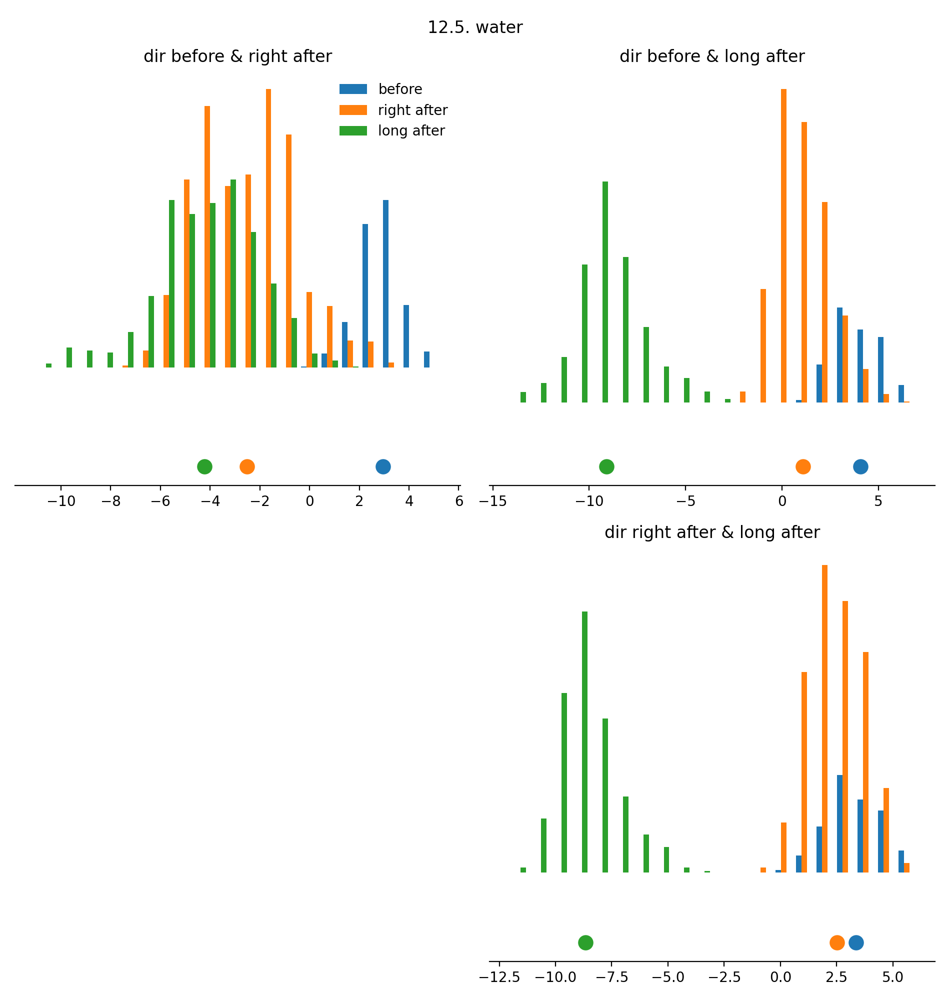

<IPython.core.display.Javascript object>


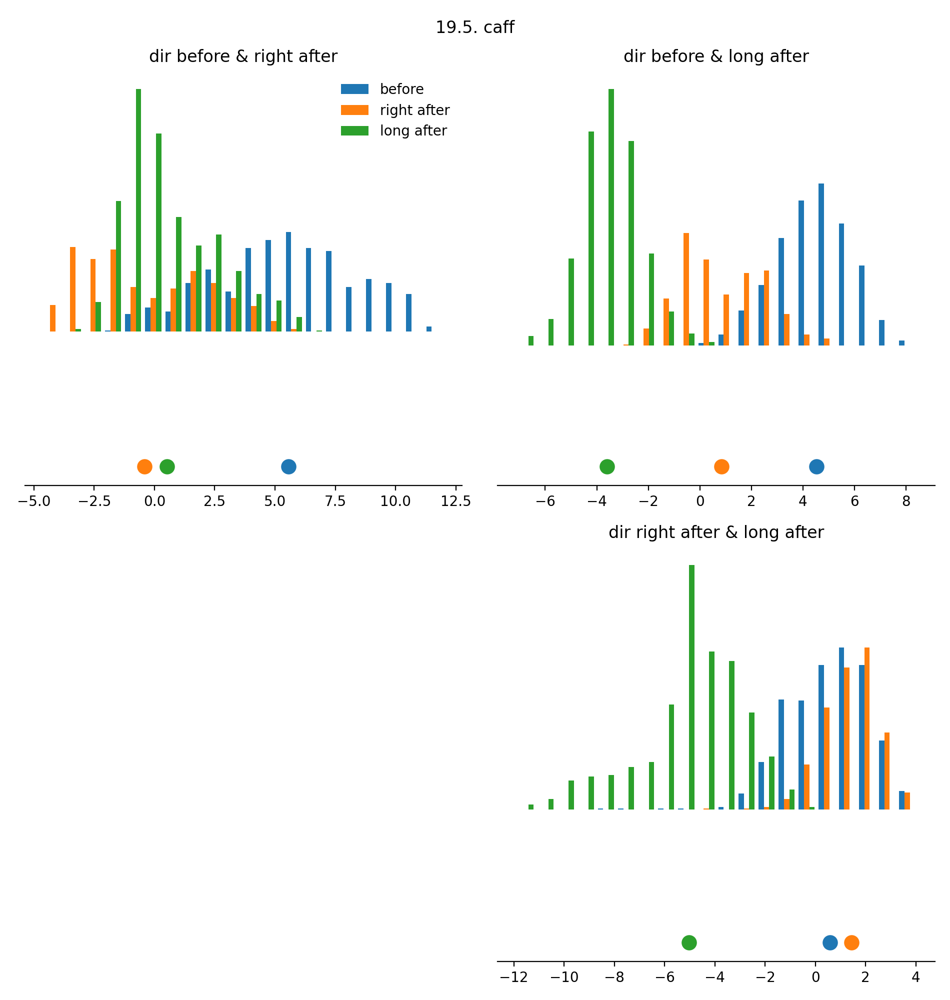

<IPython.core.display.Javascript object>


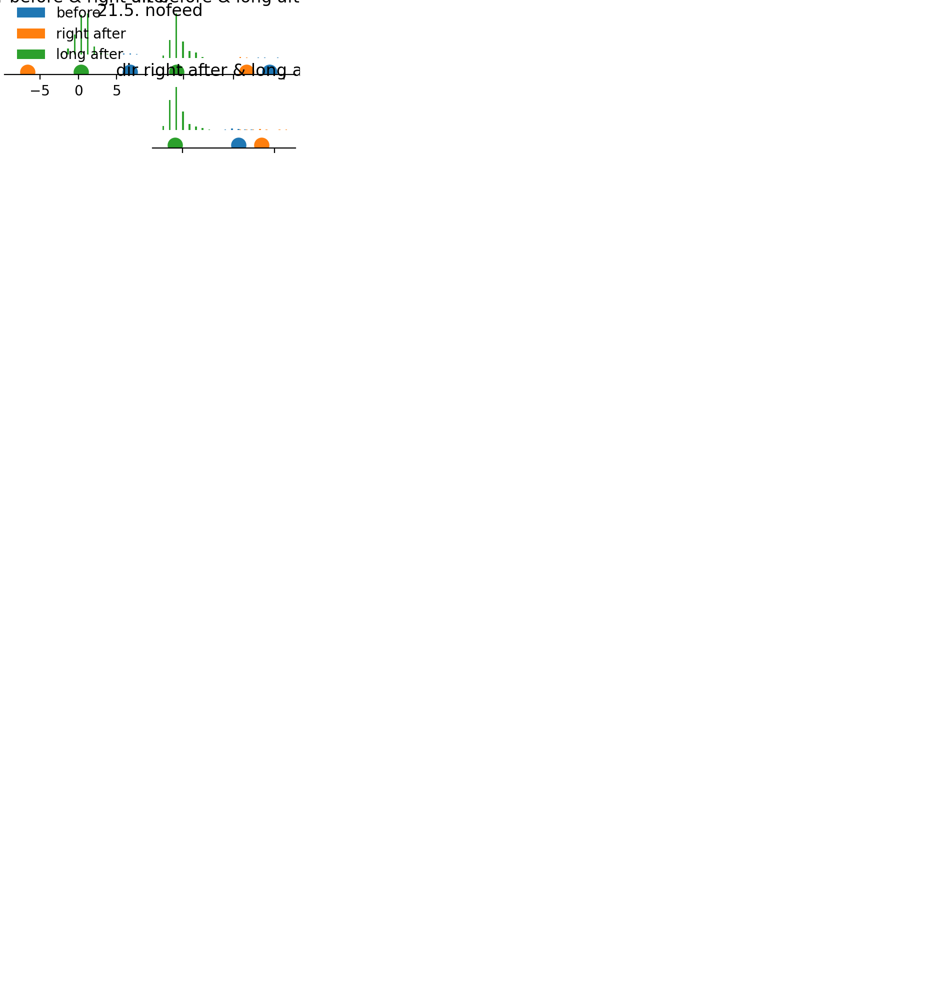

<IPython.core.display.Javascript object>


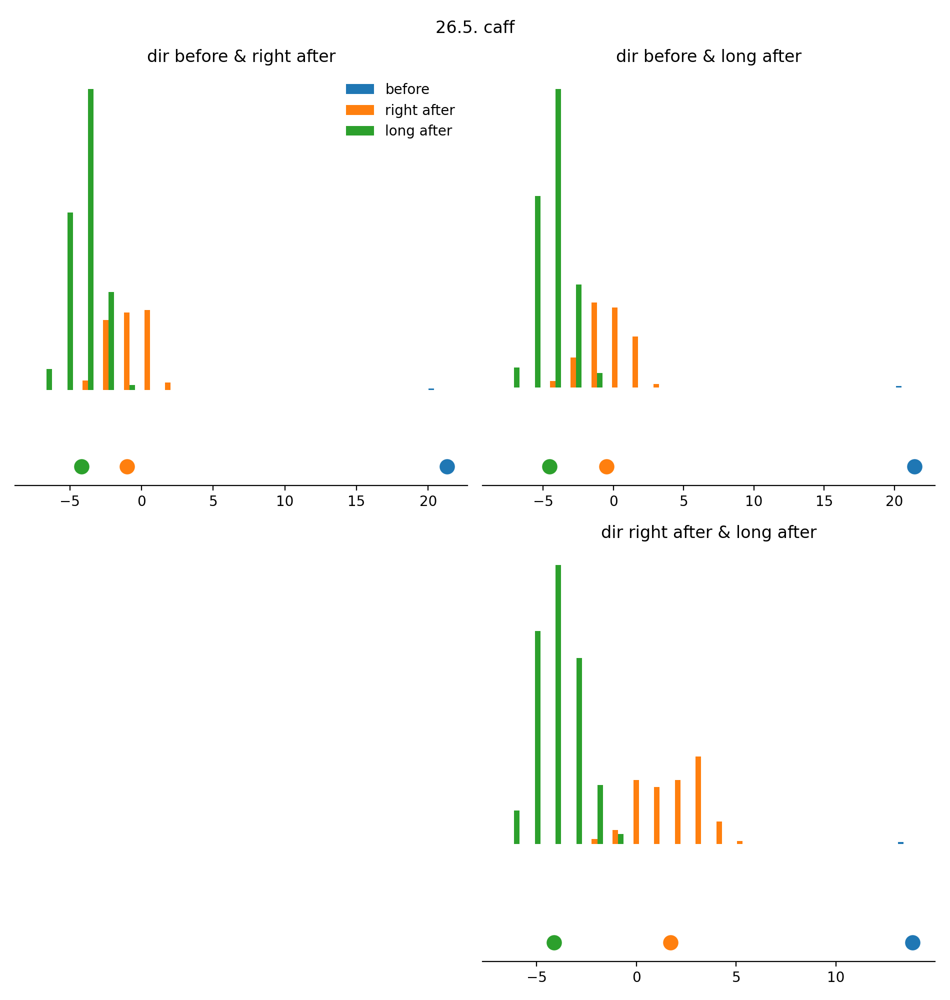

<IPython.core.display.Javascript object>


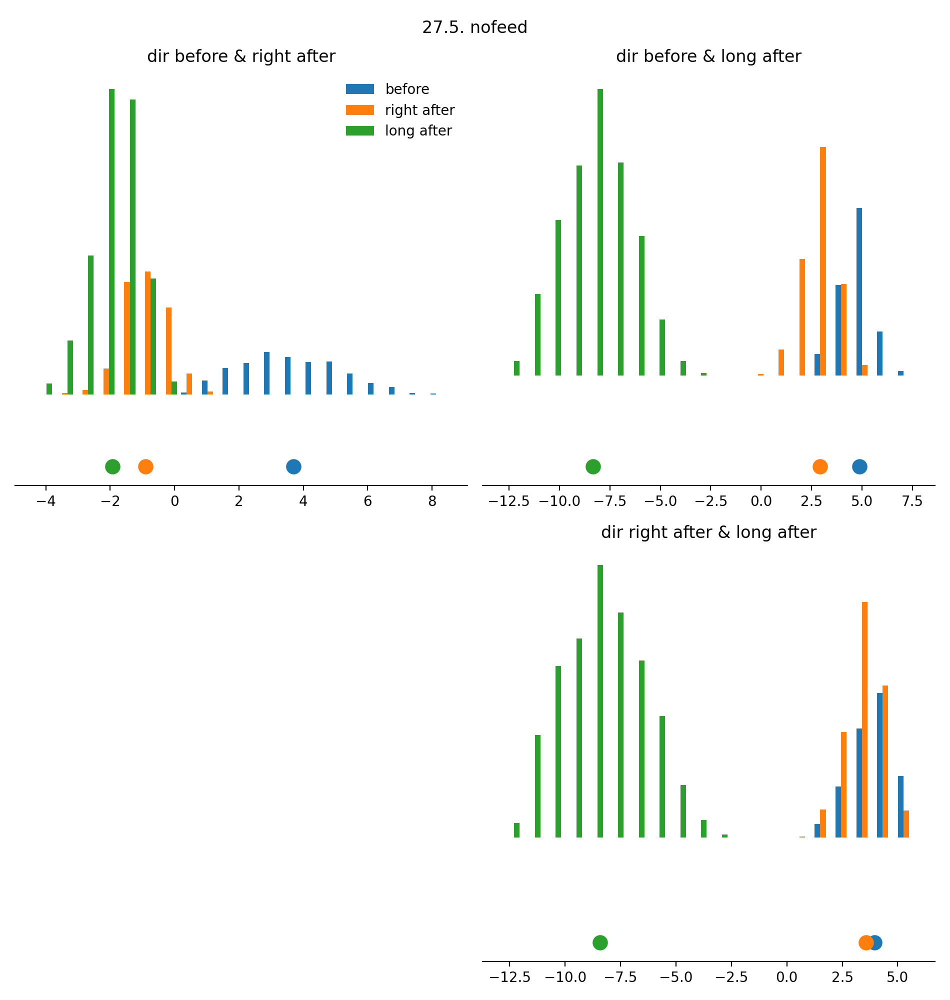

In [28]:
%matplotlib notebook
for i_fly in range(N_flies):
    an.plot_proj_hists(all_w_inter_pca_walk[i_fly], all_neurons_walk[i_fly], trials=np.arange(3), 
                   X_names=["before", "right after", "long after"], name=conditions[i_fly])

<IPython.core.display.Javascript object>


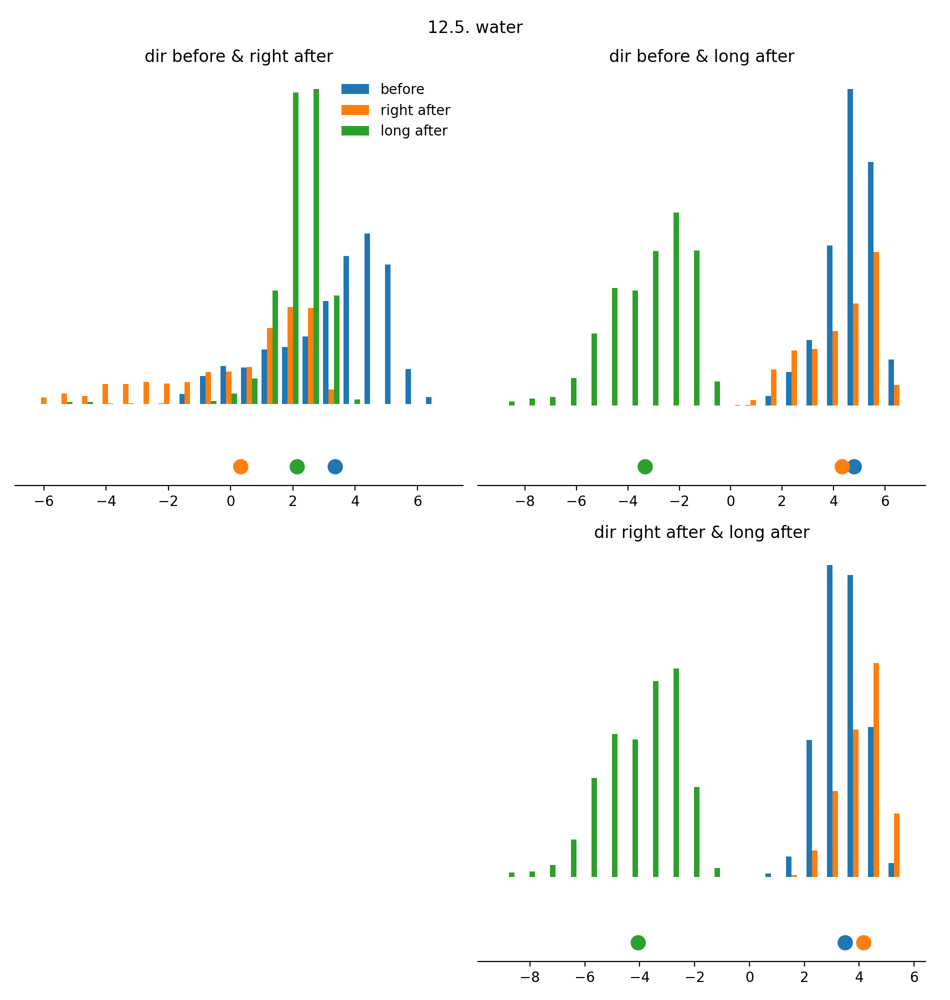

<IPython.core.display.Javascript object>


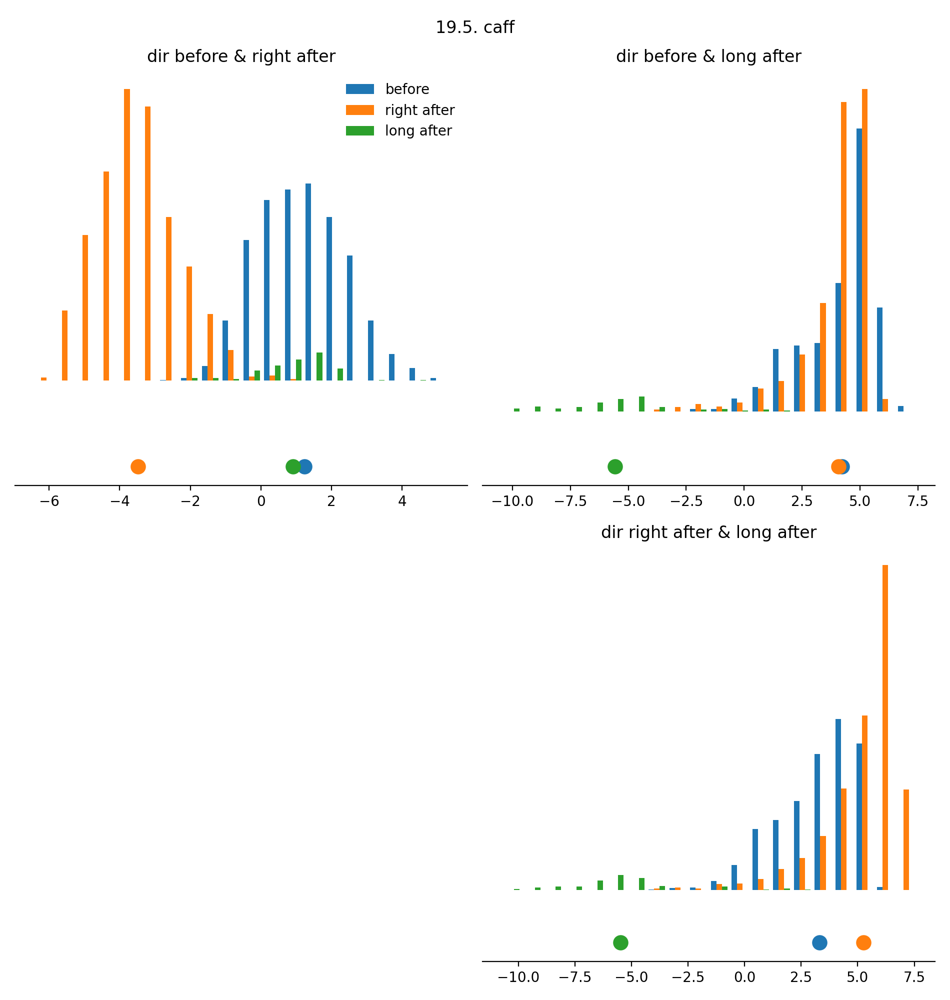

<IPython.core.display.Javascript object>


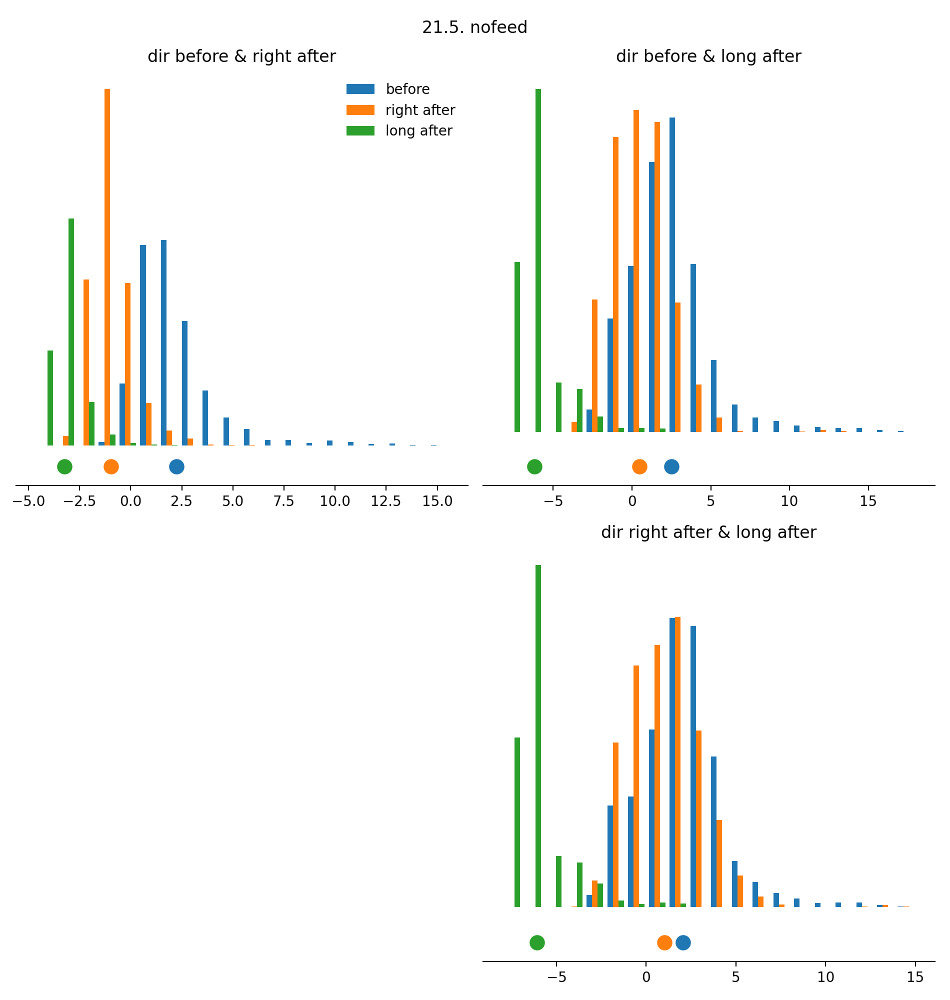

<IPython.core.display.Javascript object>


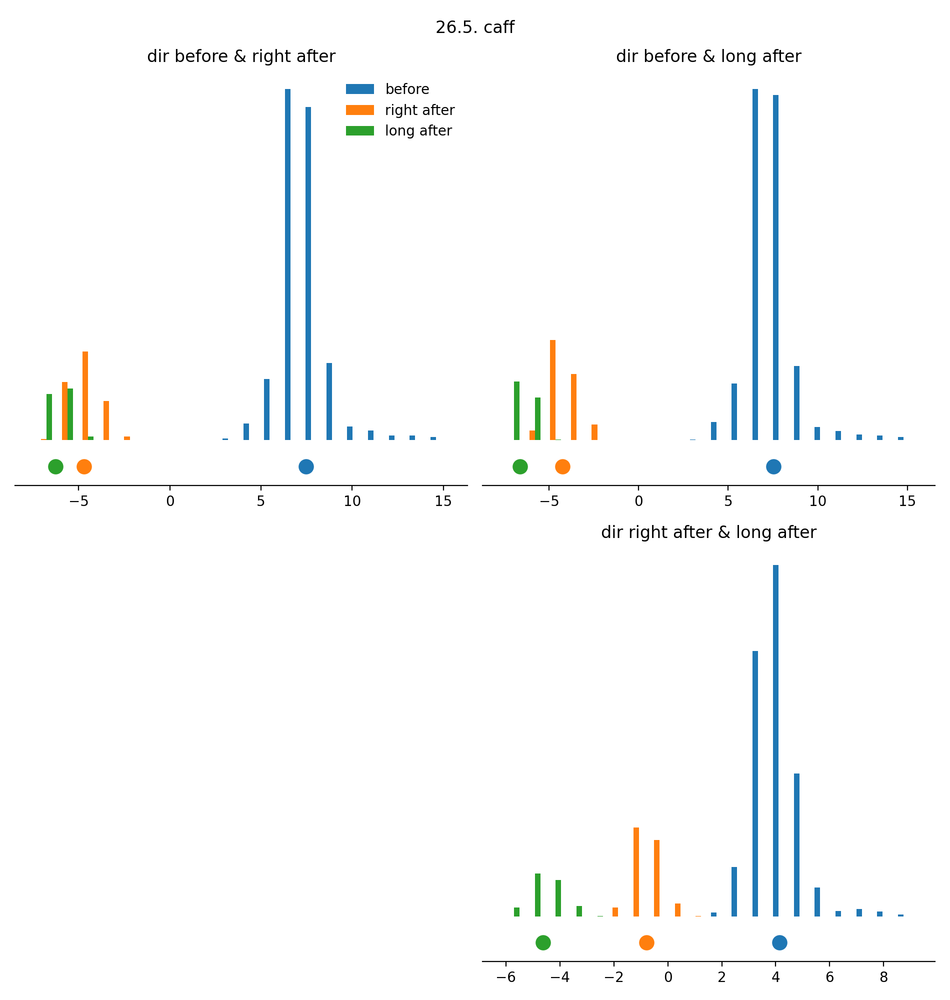

<IPython.core.display.Javascript object>


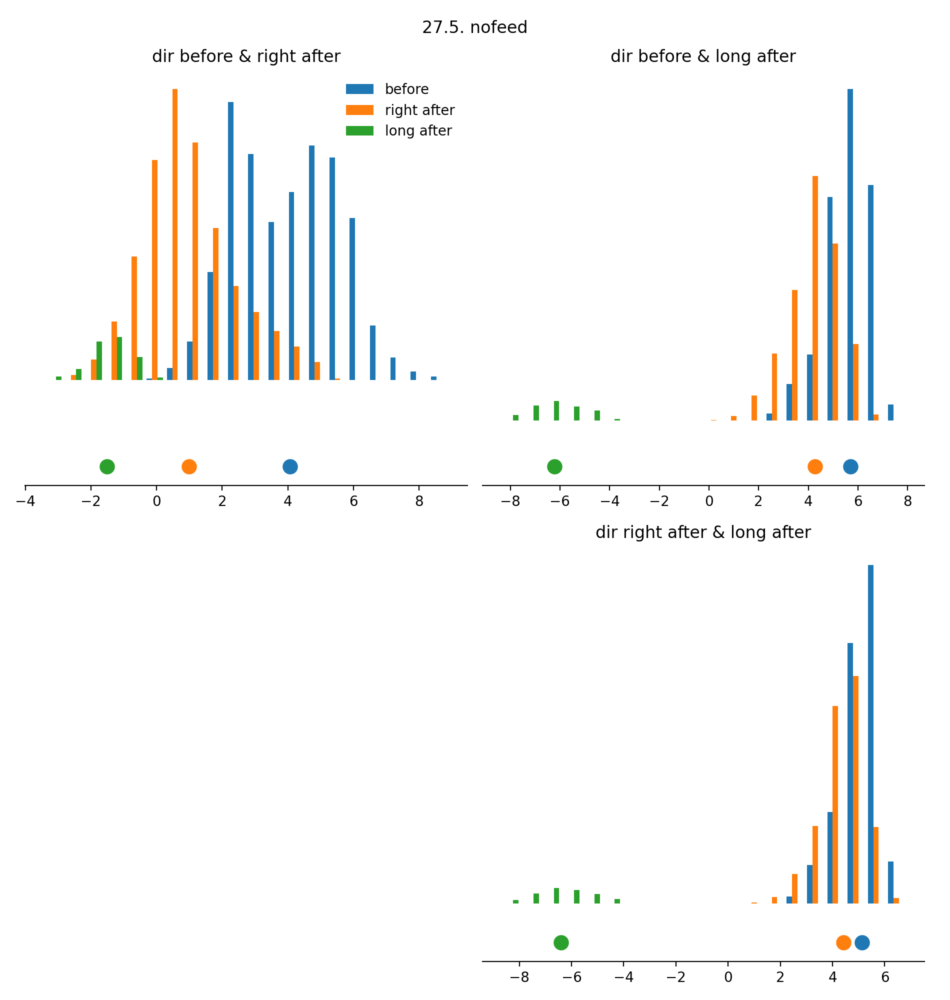

In [29]:
%matplotlib notebook
for i_fly in range(N_flies):
    an.plot_proj_hists(all_w_inter_pca_rest[i_fly], all_neurons_rest[i_fly], trials=np.arange(3), 
                   X_names=["before", "right after", "long after"], name=conditions[i_fly])

In [30]:
all_neurons_walk[3]

[array([[ 2.76684976,  0.60426415,  1.4800784 ,  1.74249835,  3.61747806,
         -0.82401619,  4.11921308,  1.26588494,  2.55817319,  1.58703042,
          5.3317235 ,  1.60032797,  2.67781207,  0.03597679,  2.54585423,
          2.32113076,  3.06276838,  1.89528812,  5.55193849,  0.69664155,
          2.96297662,  1.86445008,  1.58796644,  1.7561392 ,  2.5595647 ,
          3.12501727,  0.96541437,  1.8925622 ,  1.82633341,  2.51694457,
          2.1079833 ,  3.06279456,  2.60230432,  2.20607037,  1.62491877,
          1.79834274,  3.00477437,  7.52347546,  1.35778227,  1.55983426,
          3.67898021,  0.5035868 ,  1.52403246,  1.13928209,  1.67953162,
          2.33743901,  1.45969083,  2.80119796,  3.8022096 ,  2.95989832,
          2.845795  ,  7.0626207 ,  0.90858831,  1.95712987,  3.23221321,
          1.16773835,  3.68321257,  2.55018687,  1.22356381,  1.02437965,
          3.10197552,  0.88360642,  1.80821582,  1.70343897,  0.81695229,
          1.86713932,  3.68735245],
  

In [31]:
an = reload (an)

<IPython.core.display.Javascript object>


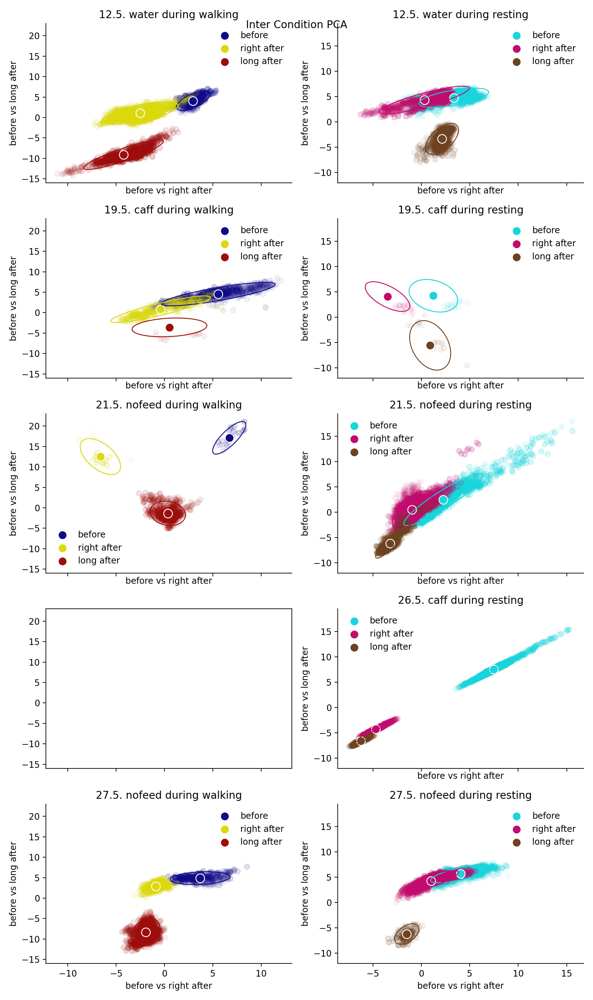

could not display data  ['before', 'right after', 'long after']
could not display data  ['before', 'right after', 'long after']
could not display data  ['before', 'right after', 'long after']
could not apply tight layout.
could not display data  ['before', 'right after', 'long after']
could not display data  ['before', 'right after', 'long after']
could not display data  ['before', 'right after', 'long after']
could not apply tight layout.


Text(0.5, 0.98, 'Inter Condition PCA')

In [32]:
%matplotlib notebook

# colors = [myplt.BLACK, myplt.DARKBLUE, myplt.DARKGREEN, myplt.DARKYELLOW, myplt.DARKORANGE, myplt.DARKRED]
# colors_contrast = [myplt.DARKGRAY, myplt.DARKBLUE_CONTRAST, myplt.DARKGREEN_CONTRAST, myplt.DARKPINK, myplt.DARKPURPLE, myplt.DARKBROWN]
colors = [myplt.DARKBLUE, myplt.DARKYELLOW, myplt.DARKRED]
colors_contrast = [myplt.DARKBLUE_CONTRAST,myplt.DARKPINK, myplt.DARKBROWN]

fig, axs = plt.subplots(N_flies,2, figsize=(9.5,16), sharex="col", sharey="col")
for i_fly in range(N_flies):
    if i_fly != 3:
        an.plot_proj_scatter(w_1=all_w_inter_pca_walk[i_fly][0,1], w_2=all_w_inter_pca_walk[i_fly][0,2],
                     X_trials=all_neurons_walk[i_fly], trials=[0,1,2], w_names=["before vs right after", "before vs long after"],
                     X_names=["before", "right after", "long after"], 
                     fig=fig, ax=axs[i_fly,0], alpha=0.1, name=conditions[i_fly]+" during walking",colors=colors)
    an.plot_proj_scatter(w_1=all_w_inter_pca_rest[i_fly][0,1], w_2=all_w_inter_pca_rest[i_fly][0,2],
                 X_trials=all_neurons_rest[i_fly], trials=[0,1,2], w_names=["before vs right after", "before vs long after"],
                 X_names=["before", "right after", "long after"], 
                 fig=fig, ax=axs[i_fly,1], alpha=0.1, name=conditions[i_fly]+" during resting",colors=colors_contrast)
fig.suptitle("Inter Condition PCA")

In [ ]:
%matplotlib notebook

# colors = [myplt.BLACK, myplt.DARKBLUE, myplt.DARKGREEN, myplt.DARKYELLOW, myplt.DARKORANGE, myplt.DARKRED]
# colors_contrast = [myplt.DARKGRAY, myplt.DARKBLUE_CONTRAST, myplt.DARKGREEN_CONTRAST, myplt.DARKPINK, myplt.DARKPURPLE, myplt.DARKBROWN]
colors = [myplt.DARKBLUE, myplt.DARKYELLOW, myplt.DARKRED]
colors_contrast = [myplt.DARKBLUE_CONTRAST,myplt.DARKPINK, myplt.DARKBROWN]

fig, axs = plt.subplots(N_flies,2, figsize=(9.5,12), sharex="col")  # , sharey="row")

for i_fly in range(N_flies):
    an.plot_proj_scatter(w_1=all_w_inter_pca[i_fly], w_2=all_w_inter_pca_walk[i_fly][0,1],
                 X_trials=all_neurons_walk[i_fly], trials=[0,1,2], w_names=["walking vs resting", "before vs right after"],
                 X_names=["walk before", "walk right after", "walk long after"], 
                 fig=fig, ax=axs[i_fly,0], alpha=0.1, name=conditions[i_fly],colors=colors)
    an.plot_proj_scatter(w_1=all_w_inter_pca[i_fly], w_2=all_w_inter_pca_rest[i_fly][0,1],
                 X_trials=all_neurons_rest[i_fly], trials=[0,1,2], w_names=["walking vs resting", "before vs right after"],
                 X_names=["rest before", "rest right after", "rest long after"],legendpos="lower left", 
                 fig=fig, ax=axs[i_fly,0], alpha=0.1, name=conditions[i_fly],colors=colors_contrast)
    
    an.plot_proj_scatter(w_1=all_w_inter_pca[i_fly], w_2=all_w_inter_pca_walk[i_fly][0,2],
                 X_trials=all_neurons_walk[i_fly], trials=[0,1,2], w_names=["walking vs resting", "before vs long after"],
                 X_names=["walk before", "walk right after", "walk long after"], 
                 fig=fig, ax=axs[i_fly,1], alpha=0.1, name=conditions[i_fly],colors=colors)
    an.plot_proj_scatter(w_1=all_w_inter_pca[i_fly], w_2=all_w_inter_pca_rest[i_fly][0,2],
                 X_trials=all_neurons_rest[i_fly], trials=[0,1,2], w_names=["walking vs resting", "before vs long after"],
                 X_names=["rest before", "rest right after", "rest long after"],legendpos="lower left", 
                 fig=fig, ax=axs[i_fly,1], alpha=0.1, name=conditions[i_fly],colors=colors_contrast)


fig.suptitle("Inter Condition PCA")

<IPython.core.display.Javascript object>

could not display data  ['walk before', 'walk right after', 'walk long after']
could not display data  ['rest before', 'rest right after', 'rest long after']
could not display data  ['rest before', 'rest right after', 'rest long after']
could not display data  ['rest before', 'rest right after', 'rest long after']
could not display data  ['walk before', 'walk right after', 'walk long after']
could not apply tight layout.


<IPython.core.display.Javascript object>


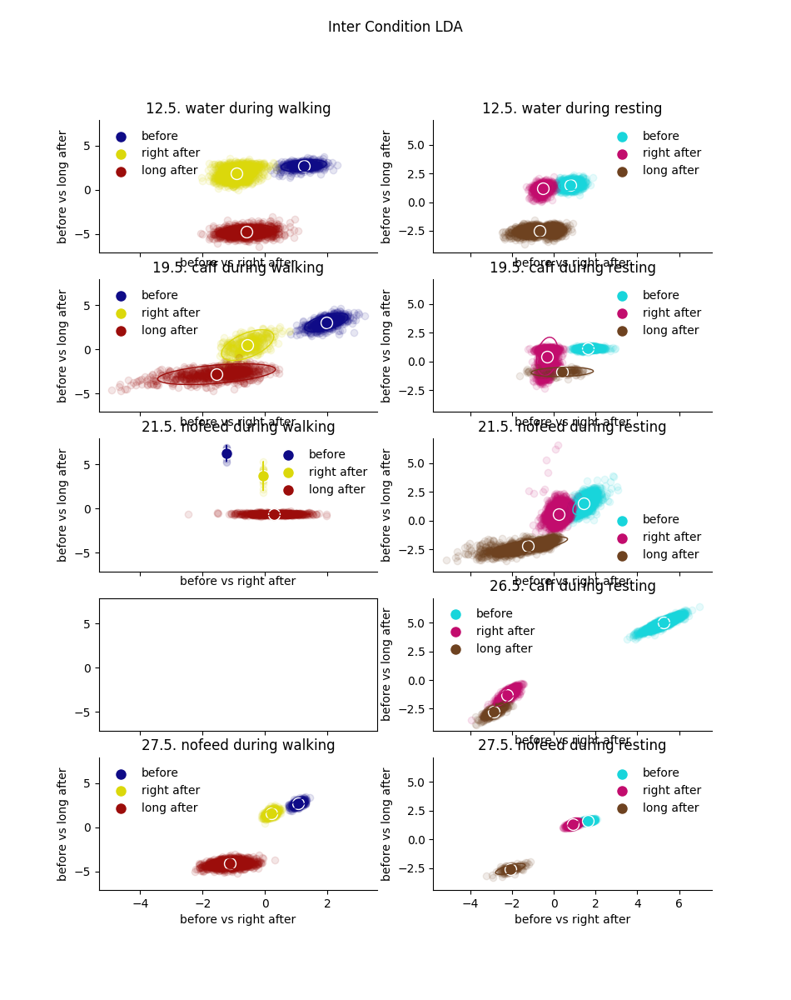

Text(0.5, 0.98, 'Inter Condition LDA')

In [125]:
%matplotlib notebook

# colors = [myplt.BLACK, myplt.DARKBLUE, myplt.DARKGREEN, myplt.DARKYELLOW, myplt.DARKORANGE, myplt.DARKRED]
# colors_contrast = [myplt.DARKGRAY, myplt.DARKBLUE_CONTRAST, myplt.DARKGREEN_CONTRAST, myplt.DARKPINK, myplt.DARKPURPLE, myplt.DARKBROWN]
colors = [myplt.DARKBLUE, myplt.DARKYELLOW, myplt.DARKRED]
colors_contrast = [myplt.DARKBLUE_CONTRAST,myplt.DARKPINK, myplt.DARKBROWN]

fig, axs = plt.subplots(N_flies,2, figsize=(9.5,12), sharex="col", sharey="col")
for i_fly in range(N_flies):
    if i_fly != 3:
        an.plot_proj_scatter(w_1=all_w_inter_lda_walk[i_fly][0,1], w_2=all_w_inter_lda_walk[i_fly][0,2],
                     X_trials=all_neurons_walk[i_fly], trials=[0,1,2], w_names=["before vs right after", "before vs long after"],
                     X_names=["before", "right after", "long after"], 
                     fig=fig, ax=axs[i_fly,0], alpha=0.1, name=conditions[i_fly]+" during walking",colors=colors)
    an.plot_proj_scatter(w_1=all_w_inter_lda_rest[i_fly][0,1], w_2=all_w_inter_lda_rest[i_fly][0,2],
                 X_trials=all_neurons_rest[i_fly], trials=[0,1,2], w_names=["before vs right after", "before vs long after"],
                 X_names=["before", "right after", "long after"], 
                 fig=fig, ax=axs[i_fly,1], alpha=0.1, name=conditions[i_fly]+" during resting",colors=colors_contrast)

fig.suptitle("Inter Condition LDA")

<IPython.core.display.Javascript object>


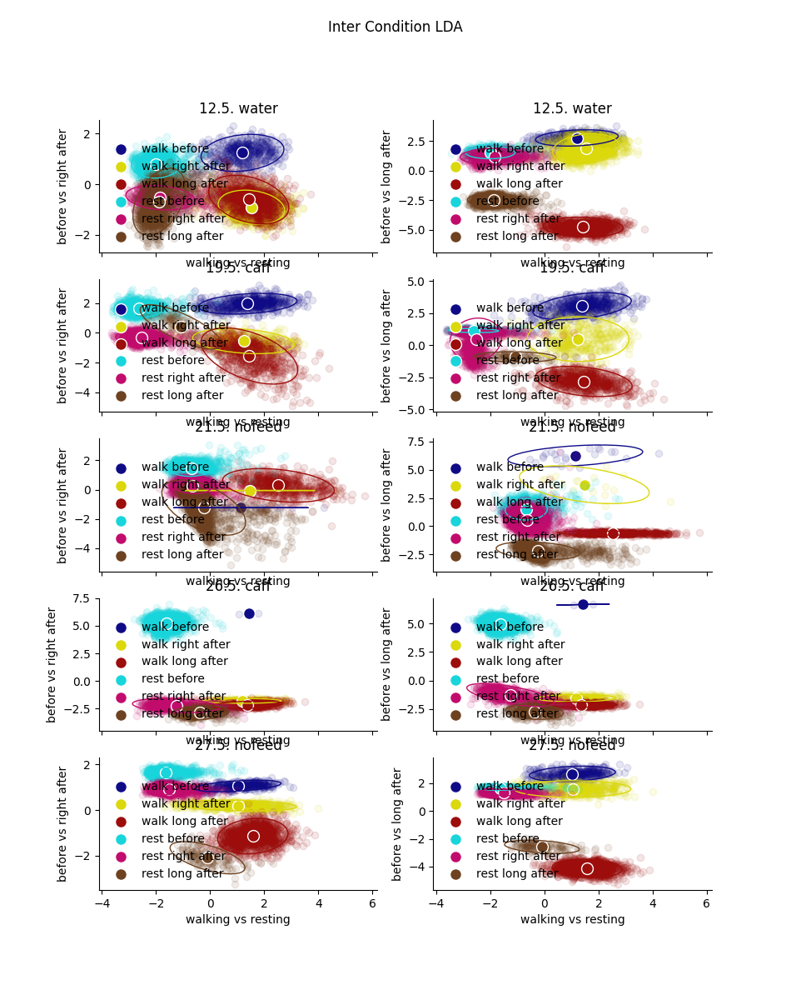

/home/jbraun/projects/longterm/longterm/plot/__init__.py:99: RuntimeWarning: invalid value encountered in sqrt
  ell_radius_y = np.sqrt(1 - pearson)


Text(0.5, 0.98, 'Inter Condition LDA')

In [126]:
%matplotlib notebook

# colors = [myplt.BLACK, myplt.DARKBLUE, myplt.DARKGREEN, myplt.DARKYELLOW, myplt.DARKORANGE, myplt.DARKRED]
# colors_contrast = [myplt.DARKGRAY, myplt.DARKBLUE_CONTRAST, myplt.DARKGREEN_CONTRAST, myplt.DARKPINK, myplt.DARKPURPLE, myplt.DARKBROWN]
colors = [myplt.DARKBLUE, myplt.DARKYELLOW, myplt.DARKRED]
colors_contrast = [myplt.DARKBLUE_CONTRAST,myplt.DARKPINK, myplt.DARKBROWN]

fig, axs = plt.subplots(N_flies,2, figsize=(9.5,12), sharex="col")  # , sharey="row")

for i_fly in range(N_flies):
    an.plot_proj_scatter(w_1=all_w_inter_lda[i_fly], w_2=all_w_inter_lda_walk[i_fly][0,1],
                 X_trials=all_neurons_walk[i_fly], trials=[0,1,2], w_names=["walking vs resting", "before vs right after"],
                 X_names=["walk before", "walk right after", "walk long after"], 
                 fig=fig, ax=axs[i_fly,0], alpha=0.1, name=conditions[i_fly],colors=colors)
    an.plot_proj_scatter(w_1=all_w_inter_lda[i_fly], w_2=all_w_inter_lda_rest[i_fly][0,1],
                 X_trials=all_neurons_rest[i_fly], trials=[0,1,2], w_names=["walking vs resting", "before vs right after"],
                 X_names=["rest before", "rest right after", "rest long after"],legendpos="lower left", 
                 fig=fig, ax=axs[i_fly,0], alpha=0.1, name=conditions[i_fly],colors=colors_contrast)
    
    an.plot_proj_scatter(w_1=all_w_inter_lda[i_fly], w_2=all_w_inter_lda_walk[i_fly][0,2],
                 X_trials=all_neurons_walk[i_fly], trials=[0,1,2], w_names=["walking vs resting", "before vs long after"],
                 X_names=["walk before", "walk right after", "walk long after"], 
                 fig=fig, ax=axs[i_fly,1], alpha=0.1, name=conditions[i_fly],colors=colors)
    an.plot_proj_scatter(w_1=all_w_inter_lda[i_fly], w_2=all_w_inter_lda_rest[i_fly][0,2],
                 X_trials=all_neurons_rest[i_fly], trials=[0,1,2], w_names=["walking vs resting", "before vs long after"],
                 X_names=["rest before", "rest right after", "rest long after"],legendpos="lower left", 
                 fig=fig, ax=axs[i_fly,1], alpha=0.1, name=conditions[i_fly],colors=colors_contrast)


fig.suptitle("Inter Condition LDA")

# look at positions of neurons in CC

In [30]:
all_neural_data_dirs = [[os.path.join(processed_dir, "green_denoised_t1.tif") 
                         for processed_dir in processed_dirs] 
                        for processed_dirs in all_processed_dirs]
all_neural_datas = [[utils.get_stack(neural_data_dir) 
                     for neural_data_dir in neural_data_dirs] 
                    for neural_data_dirs in all_neural_data_dirs

In [9]:
shapes = [[25, 305, 110, 520],
          [40, 275, 75, 515],
          [40,290, 90, 510],
          [45,300, 100, 490],
          [55,300, 75, 515],
          [45, 305, 80, 500]]

<IPython.core.display.Javascript object>


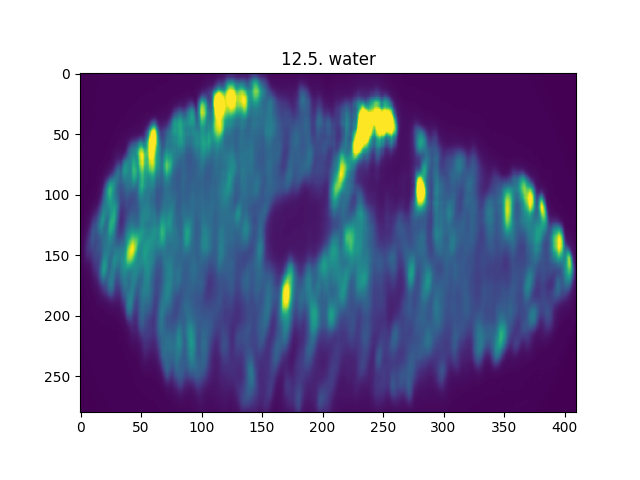

<IPython.core.display.Javascript object>


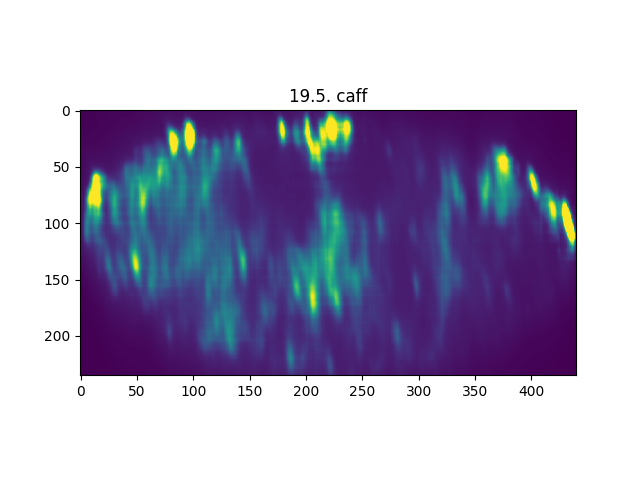

<IPython.core.display.Javascript object>


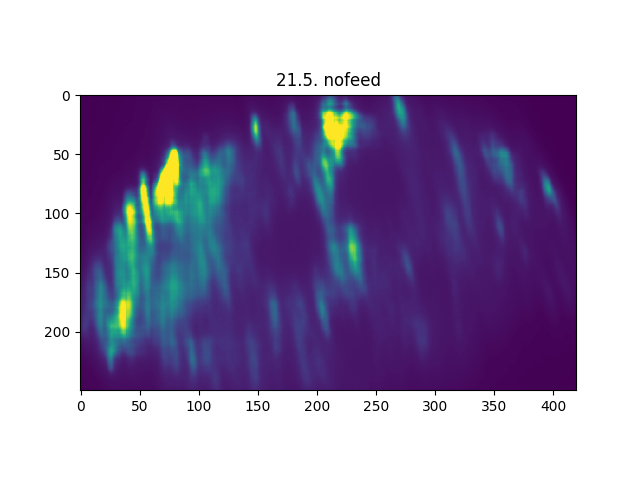

<IPython.core.display.Javascript object>


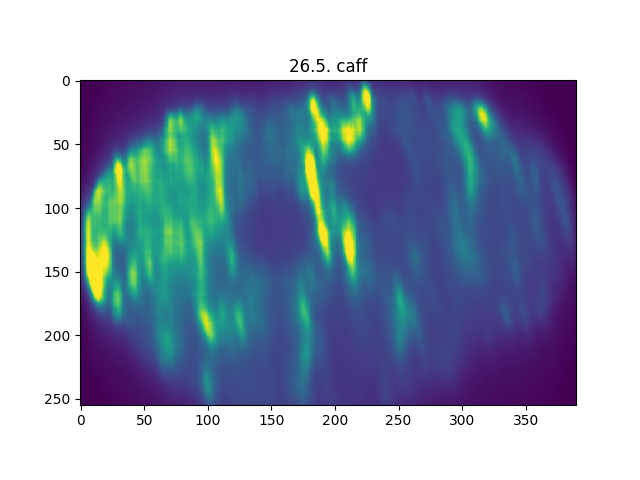

<IPython.core.display.Javascript object>


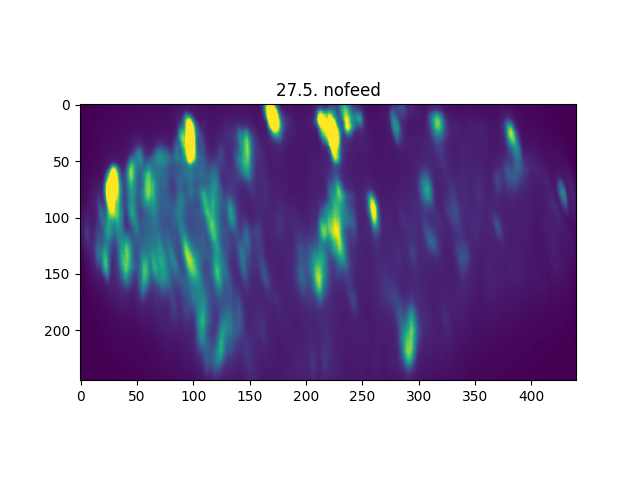

In [139]:
%matplotlib notebook
for i_fly in range(N_flies):
    plt.figure()
    std = np.std(np.concatenate(all_neural_datas[i_fly]), axis=0)[shapes[i_fly][0]:shapes[i_fly][1], shapes[i_fly][2]: shapes[i_fly][3]]
    plt.imshow(std, clim=[np.quantile(std, 0.01), np.quantile(std, 0.99)])
    plt.title(conditions[i_fly])
    

In [10]:
all_neural_datas = [[neural_data[:, shape[0]:shape[1], shape[2]: shape[3]] for neural_data in neural_datas] 
                    for neural_datas, shape in zip(all_neural_datas, shapes)]

In [11]:
[neural_datas[0].shape
                    for neural_datas, shape in zip(all_neural_datas, shapes)]

[(3840, 280, 410),
 (3840, 235, 440),
 (3840, 250, 420),
 (3840, 255, 390),
 (3840, 245, 440)]

In [12]:
all_neurons_flat_datas = [[np.reshape(neural_data, (neural_data.shape[0], -1)) 
                      for neural_data in neural_datas] 
                     for neural_datas in all_neural_datas]

In [13]:
del all_neural_datas

In [14]:
all_neurons_flat_mean = [np.concatenate(neural_flat_datas).mean(axis=0) for neural_flat_datas in all_neurons_flat_datas]
all_neurons_flat_std = [np.concatenate(neural_flat_datas).std(axis=0) for neural_flat_datas in all_neurons_flat_datas]
all_neural_flat_datas = [[(neural_flat_data - neurons_flat_mean) / neurons_flat_std for neural_flat_data in neural_flat_datas] 
                         for neural_flat_datas, neurons_flat_mean, neurons_flat_std \
                          in zip(all_neurons_flat_datas, all_neurons_flat_mean, all_neurons_flat_std)]

In [15]:
all_neurons_flat_datas_walk = [[neuron[walk_strict_red, :] for neuron, walk_strict_red in zip(neural_flat_datas, walk_strict_reds)] 
                                   for neural_flat_datas, walk_strict_reds in zip(all_neurons_flat_datas, all_walk_strict_reds)]
all_neurons_flat_datas_rest = [[neuron[rest_strict_red, :] for neuron, rest_strict_red in zip(neural_flat_datas, rest_strict_reds)] 
                                   for neural_flat_datas, rest_strict_reds in zip(all_neurons_flat_datas, all_rest_strict_reds)]

In [16]:
del all_neural_flat_datas

In [17]:
all_w_inter_pca_walk_rest_flat = [an.inter_condition_pca(np.concatenate(neural_flat_datas_walk, axis=0), 
                                                         np.concatenate(neural_flat_datas_rest, axis=0))
                                  for neural_flat_datas_walk, neural_flat_datas_rest in \
                                  zip(all_neurons_flat_datas_walk, all_neurons_flat_datas_rest)]

In [18]:
all_w_inter_pca_walk_1_flat = [an.inter_condition_pca(neural_flat_datas_walk[0], neural_flat_datas_walk[1]) 
                               for neural_flat_datas_walk, neural_flat_datas_rest \
                               in zip(all_neurons_flat_datas_walk, all_neurons_flat_datas_rest)]
all_w_inter_pca_walk_2_flat = [an.inter_condition_pca(neural_flat_datas_walk[0], neural_flat_datas_walk[2]) 
                               for neural_flat_datas_walk, neural_flat_datas_rest \
                               in zip(all_neurons_flat_datas_walk, all_neurons_flat_datas_rest)]
all_w_inter_pca_rest_1_flat = [an.inter_condition_pca(neural_flat_datas_rest[0], neural_flat_datas_rest[1]) 
                               for neural_flat_datas_walk, neural_flat_datas_rest \
                               in zip(all_neurons_flat_datas_walk, all_neurons_flat_datas_rest)]
all_w_inter_pca_rest_2_flat = [an.inter_condition_pca(neural_flat_datas_rest[0], neural_flat_datas_rest[2]) 
                               for neural_flat_datas_walk, neural_flat_datas_rest \
                               in zip(all_neurons_flat_datas_walk, all_neurons_flat_datas_rest)]

/home/jbraun/projects/longterm/longterm/analysis/__init__.py:125: RuntimeWarning: Mean of empty slice.
  w = X1.mean(axis=0) - X2.mean(axis=0)
/home/jbraun/anaconda3/envs/longterm37/lib/python3.7/site-packages/numpy/core/_methods.py:181: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


/home/jbraun/anaconda3/envs/longterm37/lib/python3.7/site-packages/ipykernel_launcher.py:12: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  if sys.path[0] == '':
/home/jbraun/anaconda3/envs/longterm37/lib/python3.7/site-packages/ipykernel_launcher.py:13: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review yo

<IPython.core.display.Javascript object>


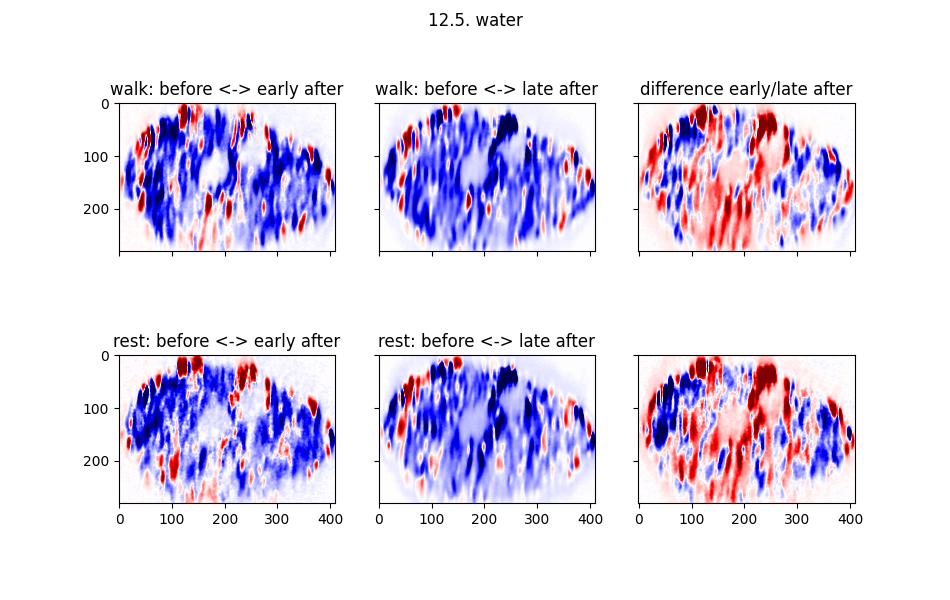

<IPython.core.display.Javascript object>


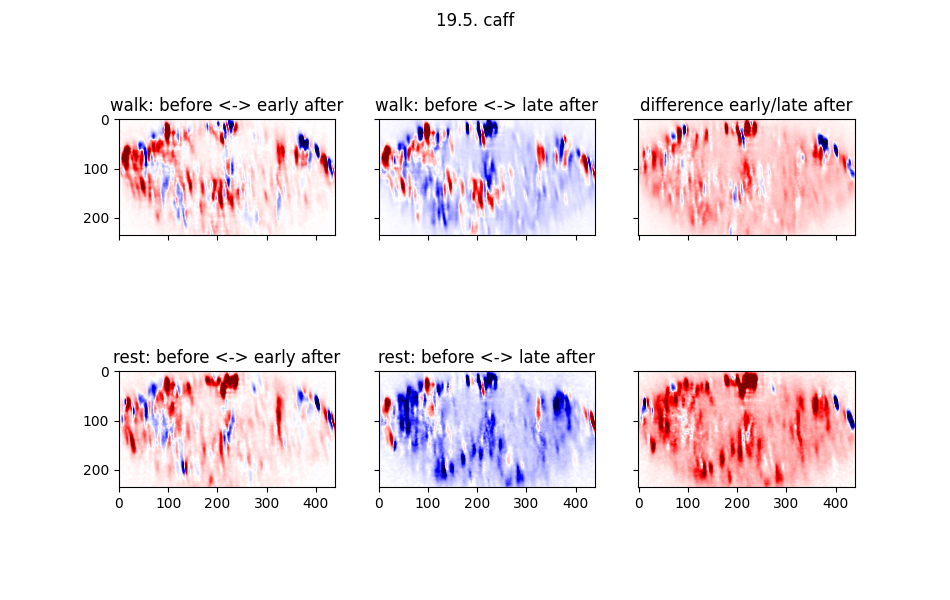

<IPython.core.display.Javascript object>


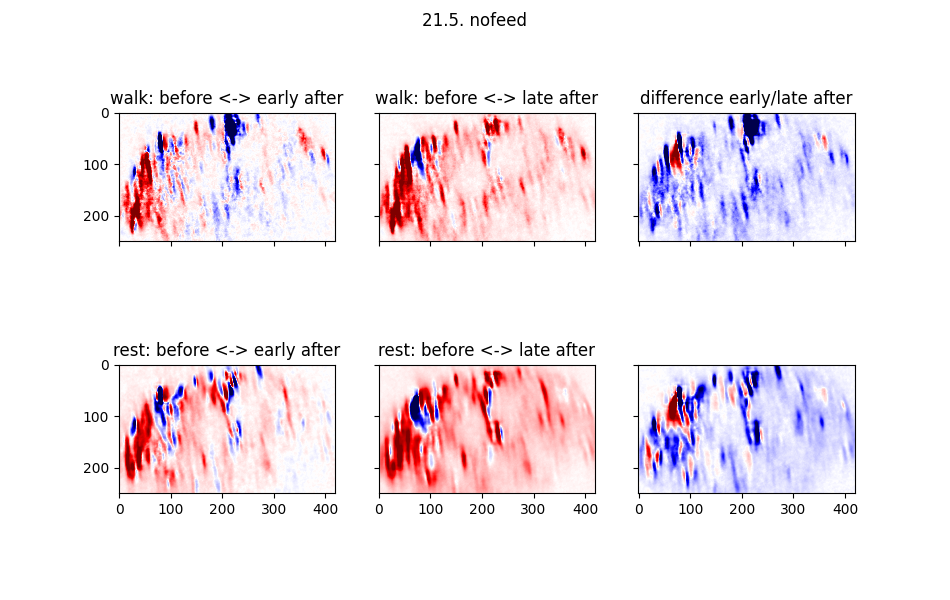

<IPython.core.display.Javascript object>


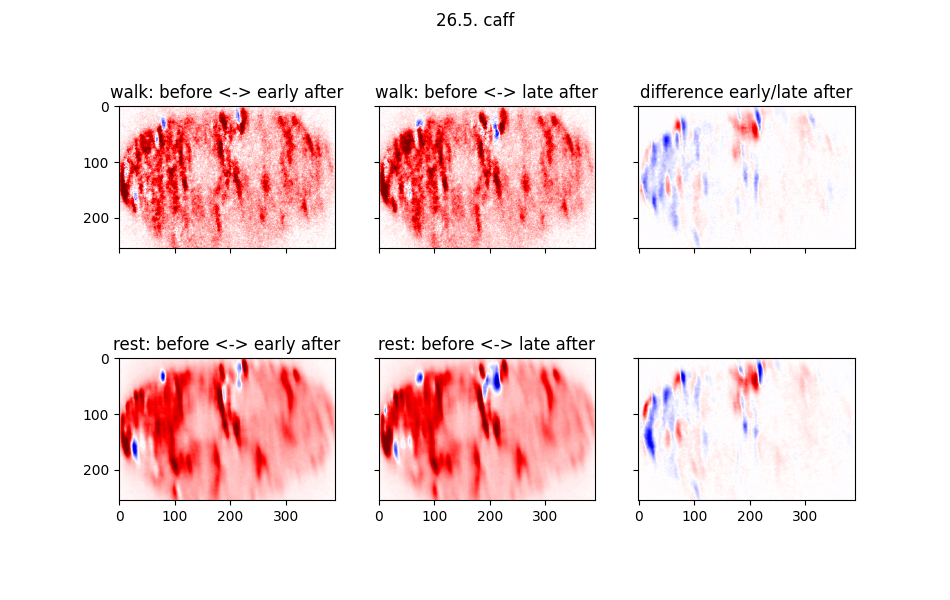

<IPython.core.display.Javascript object>


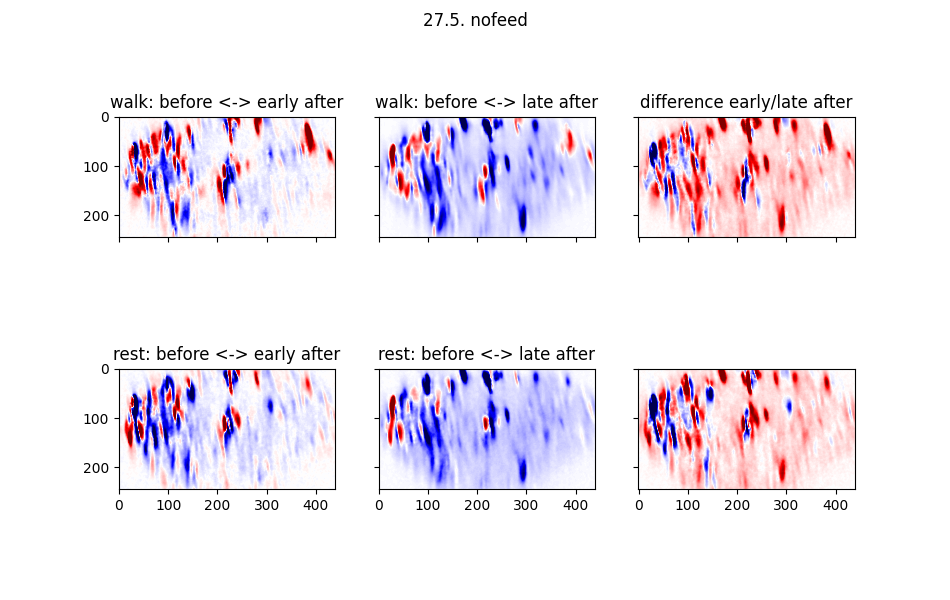

In [51]:
%matplotlib notebook

for i_fly in range(N_flies):
    shape = shapes[i_fly]
    size_y = shape[1] - shape[0]
    w_inter_pca_walk_1 = all_w_inter_pca_walk_1_flat[i_fly].reshape(size_y,-1)
    w_inter_pca_walk_2 = all_w_inter_pca_walk_2_flat[i_fly].reshape(size_y,-1)
    w_inter_pca_rest_1 = all_w_inter_pca_rest_1_flat[i_fly].reshape(size_y,-1)
    w_inter_pca_rest_2 = all_w_inter_pca_rest_2_flat[i_fly].reshape(size_y,-1)
    
    clim = np.quantile(w_inter_pca_walk_1, 0.99)
    contrib_walk = np.logical_or(w_inter_pca_walk_1 > clim, w_inter_pca_walk_1 < -clim).astype(np.int)
    contrib_rest = np.logical_or(w_inter_pca_rest_1 > clim, w_inter_pca_rest_1 < -clim).astype(np.int)
    diff_contrib_walk = np.abs(w_inter_pca_walk_1) - np.abs(w_inter_pca_walk_1)
    diff_contrib_rest = np.abs(w_inter_pca_rest_1) - np.abs(w_inter_pca_rest_1)
    diff_contrib = (np.abs(w_inter_pca_walk_1) - np.abs(w_inter_pca_rest_1)) > clim
    fig, axs = plt.subplots(2,3, figsize=(9.5, 6), sharex=True, sharey=True)
    
    axs[0,0].imshow(w_inter_pca_walk_1, clim=[-clim, clim], cmap=plt.cm.get_cmap("seismic"))
    axs[0,0].set_title("walk: before <-> early after")
    axs[0,1].imshow(w_inter_pca_walk_2, clim=[-clim, clim], cmap=plt.cm.get_cmap("seismic"))
    axs[0,1].set_title("walk: before <-> late after")
    axs[0,2].imshow(w_inter_pca_walk_1-w_inter_pca_walk_2, clim=[-clim, clim], cmap=plt.cm.get_cmap("seismic"))
    axs[0,2].set_title("difference early/late after")
    
    axs[1,0].imshow(w_inter_pca_rest_1, clim=[-clim, clim], cmap=plt.cm.get_cmap("seismic"))
    axs[1,0].set_title("rest: before <-> early after")
    axs[1,1].imshow(w_inter_pca_rest_2, clim=[-clim, clim], cmap=plt.cm.get_cmap("seismic"))
    axs[1,1].set_title("rest: before <-> late after")
    axs[1,2].imshow(w_inter_pca_rest_1-w_inter_pca_rest_2, clim=[-clim, clim], cmap=plt.cm.get_cmap("seismic"))
    axs[0,2].set_title("difference early/late after")
    
    # axs[2,0].imshow(diff_contrib)  # contrib_walk-contrib_rest)
    # axs[2,1].axis("off")
    # axs[2,2].axis("off")
    
    
    fig.suptitle(conditions[i_fly])

In [19]:
from longterm import rois  # read_roi_center_file

In [20]:
roi_centers = [rois.read_roi_center_file(os.path.join(fly_dir, "processed", "ROI_centers.txt")) for fly_dir in fly_dirs]

Read the centers of 87 ROIs from file
Read the centers of 75 ROIs from file
Read the centers of 68 ROIs from file
Read the centers of 67 ROIs from file
Read the centers of 78 ROIs from file


/home/jbraun/anaconda3/envs/longterm37/lib/python3.7/site-packages/ipykernel_launcher.py:12: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  if sys.path[0] == '':
/home/jbraun/anaconda3/envs/longterm37/lib/python3.7/site-packages/ipykernel_launcher.py:13: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review yo

<IPython.core.display.Javascript object>


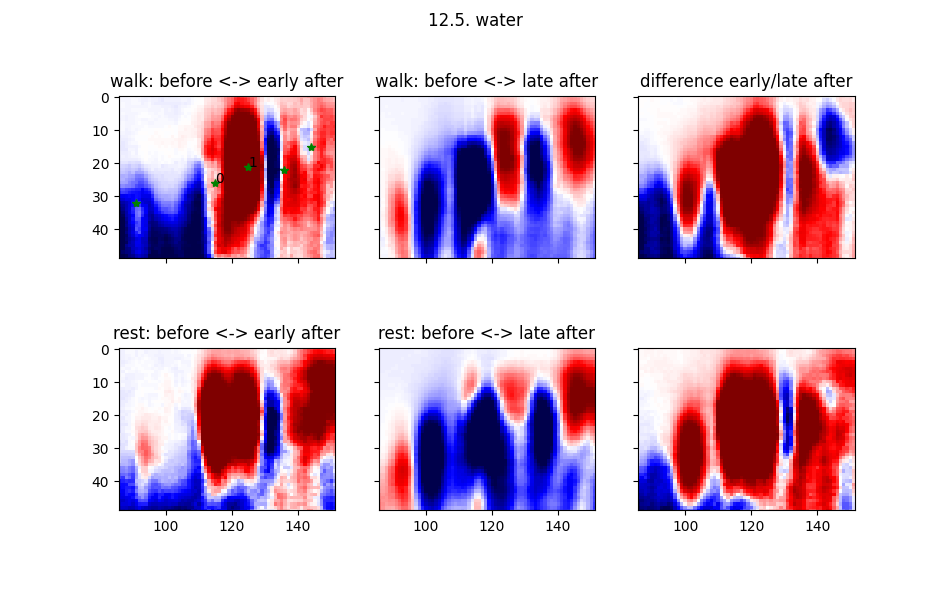

<IPython.core.display.Javascript object>


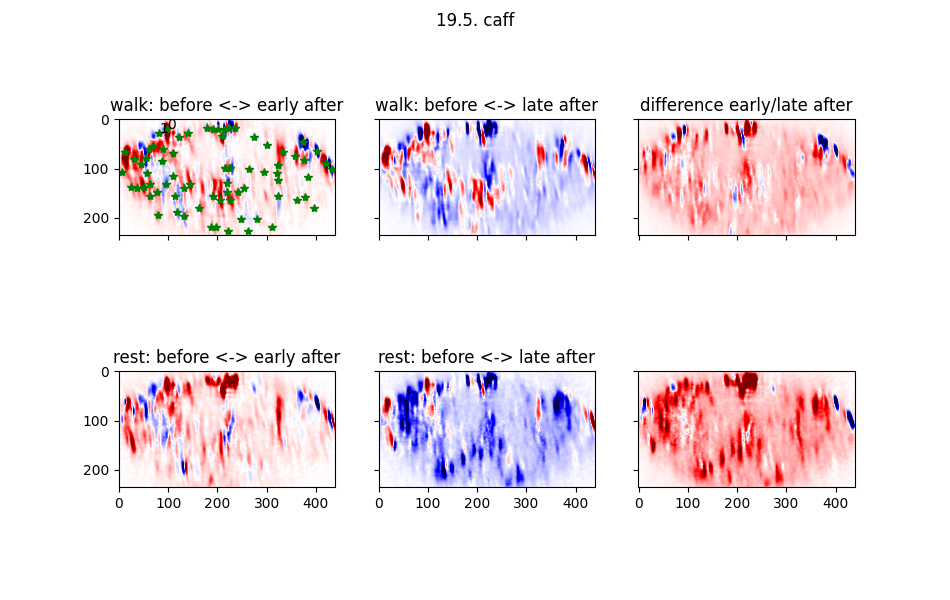

<IPython.core.display.Javascript object>


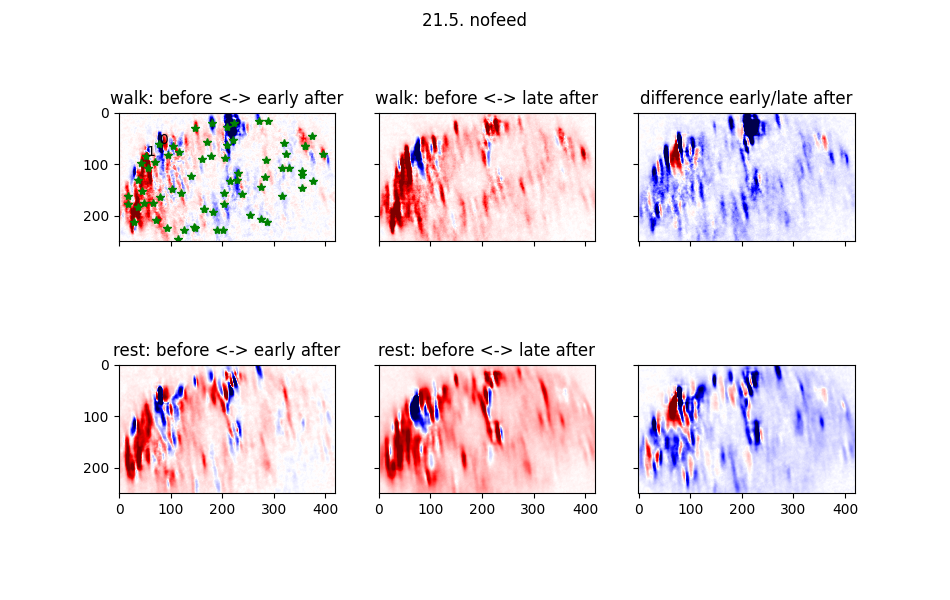

<IPython.core.display.Javascript object>


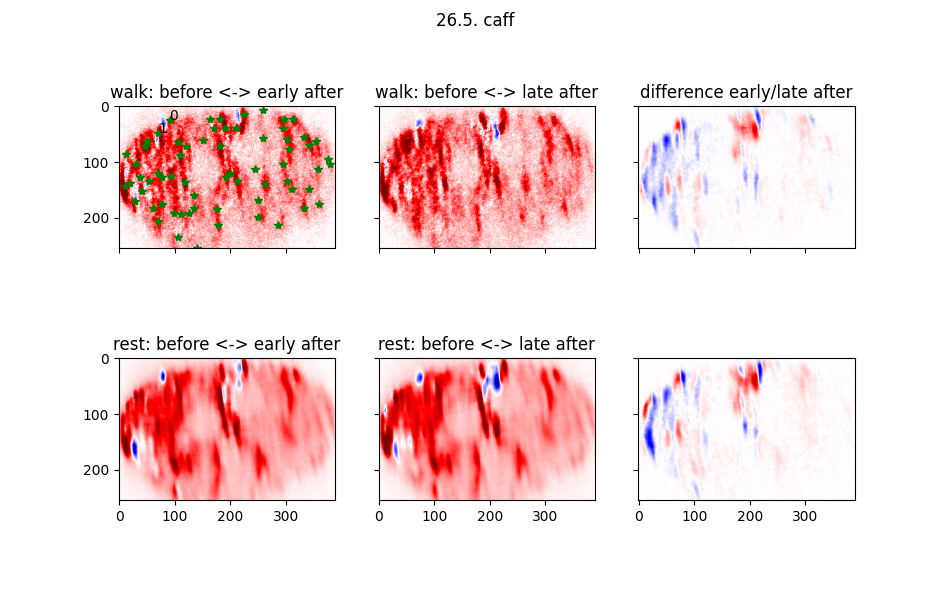

<IPython.core.display.Javascript object>


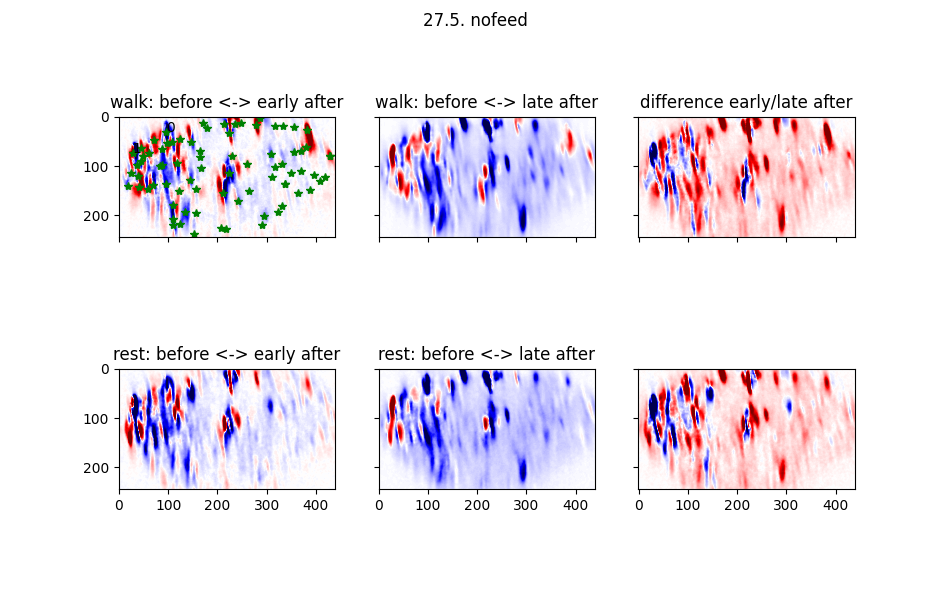

In [65]:
%matplotlib notebook

for i_fly in range(N_flies):
    shape = shapes[i_fly]
    size_y = shape[1] - shape[0]
    w_inter_pca_walk_1 = all_w_inter_pca_walk_1_flat[i_fly].reshape(size_y,-1)
    w_inter_pca_walk_2 = all_w_inter_pca_walk_2_flat[i_fly].reshape(size_y,-1)
    w_inter_pca_rest_1 = all_w_inter_pca_rest_1_flat[i_fly].reshape(size_y,-1)
    w_inter_pca_rest_2 = all_w_inter_pca_rest_2_flat[i_fly].reshape(size_y,-1)
    
    clim = np.quantile(w_inter_pca_walk_1, 0.99)
    contrib_walk = np.logical_or(w_inter_pca_walk_1 > clim, w_inter_pca_walk_1 < -clim).astype(np.int)
    contrib_rest = np.logical_or(w_inter_pca_rest_1 > clim, w_inter_pca_rest_1 < -clim).astype(np.int)
    diff_contrib_walk = np.abs(w_inter_pca_walk_1) - np.abs(w_inter_pca_walk_1)
    diff_contrib_rest = np.abs(w_inter_pca_rest_1) - np.abs(w_inter_pca_rest_1)
    diff_contrib = (np.abs(w_inter_pca_walk_1) - np.abs(w_inter_pca_rest_1)) > clim
    fig, axs = plt.subplots(2,3, figsize=(9.5, 6), sharex=True, sharey=True)
    
    axs[0,0].imshow(w_inter_pca_walk_1, clim=[-clim, clim], cmap=plt.cm.get_cmap("seismic"))
    axs[0,0].set_title("walk: before <-> early after")
    _ = [axs[0,0].plot(roi[1]-shapes[i_fly][2], roi[0]-shapes[i_fly][0], 'g*') for roi in roi_centers[i_fly]]
    for i in range(len(roi_centers[i_fly])):
        axs[0,0].annotate(str(i), np.flip(np.array(roi_centers[i_fly][i])-np.array(shapes[i_fly][::2])))
    
    axs[0,1].imshow(w_inter_pca_walk_2, clim=[-clim, clim], cmap=plt.cm.get_cmap("seismic"))
    axs[0,1].set_title("walk: before <-> late after")
    axs[0,2].imshow(w_inter_pca_walk_1-w_inter_pca_walk_2, clim=[-clim, clim], cmap=plt.cm.get_cmap("seismic"))
    axs[0,2].set_title("difference early/late after")
    
    axs[1,0].imshow(w_inter_pca_rest_1, clim=[-clim, clim], cmap=plt.cm.get_cmap("seismic"))
    axs[1,0].set_title("rest: before <-> early after")
    axs[1,1].imshow(w_inter_pca_rest_2, clim=[-clim, clim], cmap=plt.cm.get_cmap("seismic"))
    axs[1,1].set_title("rest: before <-> late after")
    axs[1,2].imshow(w_inter_pca_rest_1-w_inter_pca_rest_2, clim=[-clim, clim], cmap=plt.cm.get_cmap("seismic"))
    axs[0,2].set_title("difference early/late after")
    
    # axs[2,0].imshow(diff_contrib)  # contrib_walk-contrib_rest)
    # axs[2,1].axis("off")
    # axs[2,2].axis("off")
    
    
    fig.suptitle(conditions[i_fly])

/home/jbraun/anaconda3/envs/longterm37/lib/python3.7/site-packages/ipykernel_launcher.py:7: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  import sys
/home/jbraun/anaconda3/envs/longterm37/lib/python3.7/site-packages/ipykernel_launcher.py:8: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current us

<IPython.core.display.Javascript object>


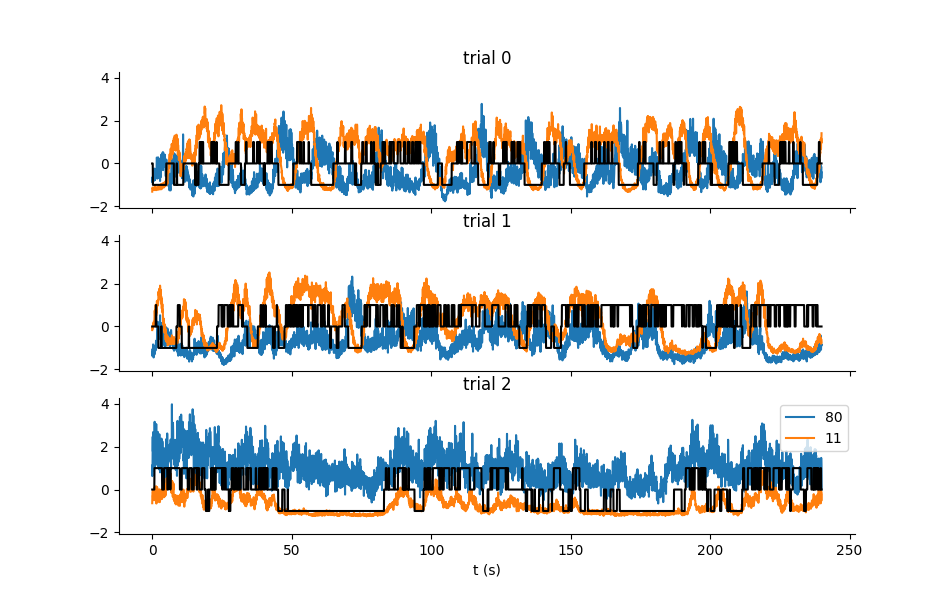

In [66]:
%matplotlib notebook
i_fly = 0
i_rois_orig = [80,11]  # [23,24] # [80,11]  # [15, 56]  # [0,1]  # [23,24]  # [40, 85]  # 
# interesting: 23, 24, 11, 1, 0
i_rois_sorted = [np.argwhere(all_sort_idx[i_fly]==i_roi)[0,0] for i_roi in i_rois_orig]
this_neurons_trials = [all_neurons[i_fly][i_trial][:, i_rois_sorted]for i_trial in range(3)]
this_rest = np.array(all_rest_strict_reds[i_fly]).astype(np.int)
this_walk = np.array(all_walk_strict_reds[i_fly]).astype(np.int)
fig, axs = plt.subplots(3,1, figsize=(9.5, 6), sharex=True, sharey=True)
for i_trial, ax in enumerate(axs):
        ax.plot(np.arange(3840)/16, this_neurons_trials[i_trial], label=i_rois_orig)
        ax.plot(np.arange(3840)/16, this_walk[i_trial]-this_rest[i_trial], 'k')
        ax.set_title("trial {}".format(i_trial))
        if i_trial == 2:
            ax.set_xlabel("t (s)")
            ax.legend()
        ax.spines["top"].set_visible(False)
        ax.spines["right"].set_visible(False)

In [ ]:
"""
all_w_inter_pca_walk_1_flat = [an.inter_condition_pca(neural_flat_datas_walk[0], neural_flat_datas_walk[1]) 
                               for neural_flat_datas_walk, neural_flat_datas_rest \
                               in zip(all_neurons_flat_datas_walk, all_neurons_flat_datas_rest)]
all_w_inter_pca_walk_2_flat = [an.inter_condition_pca(neural_flat_datas_walk[0], neural_flat_datas_walk[2]) 
                               for neural_flat_datas_walk, neural_flat_datas_rest \
                               in zip(all_neurons_flat_datas_walk, all_neurons_flat_datas_rest)]
all_w_inter_pca_rest_1_flat = [an.inter_condition_pca(neural_flat_datas_rest[0], neural_flat_datas_rest[1]) 
                               for neural_flat_datas_walk, neural_flat_datas_rest \
                               in zip(all_neurons_flat_datas_walk, all_neurons_flat_datas_rest)]
all_w_inter_pca_rest_2_flat = [an.inter_condition_pca(neural_flat_datas_rest[0], neural_flat_datas_rest[2]) 
                               for neural_flat_datas_walk, neural_flat_datas_rest \
                               in zip(all_neurons_flat_datas_walk, all_neurons_flat_datas_rest)]
"""

In [70]:
an = reload(an)

<IPython.core.display.Javascript object>


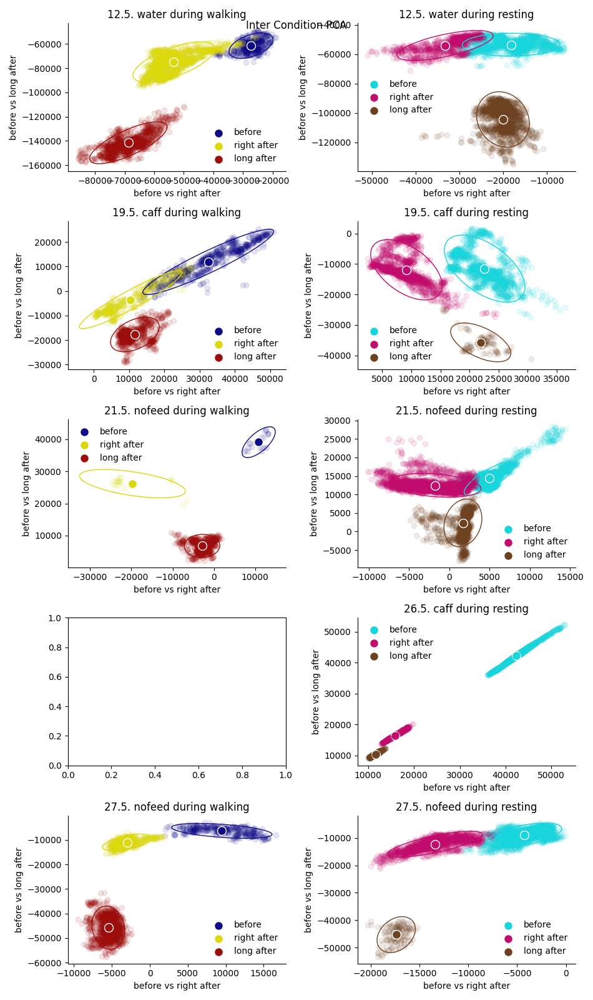

Text(0.5, 0.98, 'Inter Condition PCA')

In [71]:
%matplotlib notebook

# colors = [myplt.BLACK, myplt.DARKBLUE, myplt.DARKGREEN, myplt.DARKYELLOW, myplt.DARKORANGE, myplt.DARKRED]
# colors_contrast = [myplt.DARKGRAY, myplt.DARKBLUE_CONTRAST, myplt.DARKGREEN_CONTRAST, myplt.DARKPINK, myplt.DARKPURPLE, myplt.DARKBROWN]
colors = [myplt.DARKBLUE, myplt.DARKYELLOW, myplt.DARKRED]
colors_contrast = [myplt.DARKBLUE_CONTRAST,myplt.DARKPINK, myplt.DARKBROWN]

fig, axs = plt.subplots(N_flies,2, figsize=(9.5,16))  # , sharex="col", sharey="col")
for i_fly in range(N_flies):
    if i_fly != 3:
        an.plot_proj_scatter(w_1=all_w_inter_pca_walk_1_flat[i_fly], w_2=all_w_inter_pca_walk_2_flat[i_fly],
                     X_trials=all_neurons_flat_datas_walk[i_fly], trials=[0,1,2], w_names=["before vs right after", "before vs long after"],
                     X_names=["before", "right after", "long after"], 
                     fig=fig, ax=axs[i_fly,0], alpha=0.1, name=conditions[i_fly]+" during walking",colors=colors)
    an.plot_proj_scatter(w_1=all_w_inter_pca_rest_1_flat[i_fly], w_2=all_w_inter_pca_rest_2_flat[i_fly],
                 X_trials=all_neurons_flat_datas_rest[i_fly], trials=[0,1,2], w_names=["before vs right after", "before vs long after"],
                 X_names=["before", "right after", "long after"], 
                 fig=fig, ax=axs[i_fly,1], alpha=0.1, name=conditions[i_fly]+" during resting",colors=colors_contrast)
fig.suptitle("Inter Condition PCA")

# only look at specific neurons

In [5]:
fly_dir = os.path.join(load.NAS2_DIR_LH, "210512", "fly3")
trial_dirs = utils.readlines_tolist(os.path.join(fly_dir, "trial_dirs.txt"))
trial_dirs = [trial_dirs[i_trial] for i_trial in [0,2,3,5,8,11]]  # [2,5,11]  # 4
processed_dirs = [os.path.join(trial_dir, "processed") for trial_dir in trial_dirs]

In [6]:
neural_data_dirs = [os.path.join(processed_dir, "green_denoised_t1.tif") 
                         for processed_dir in processed_dirs]
neural_datas = [utils.get_stack(neural_data_dir) 
                     for neural_data_dir in neural_data_dirs]

In [7]:
opflow_df_dirs = [os.path.join(processed_dir, "opflow_df.pkl") for processed_dir in processed_dirs]
opflow_dfs = [pd.read_pickle(opflow_df_dir) for opflow_df_dir in opflow_df_dirs]

In [78]:
neural_df_dirs = [os.path.join(processed_dir, "twop_df.pkl") 
                       for processed_dir in processed_dirs] 
neural_dfs = [pd.read_pickle(neural_df_dir) for neural_df_dir in neural_df_dirs]

In [8]:
from longterm.behaviour import optic_flow as of

In [9]:
opflow_dfs = [of.filter_velocities(opflow_df) for opflow_df in opflow_dfs]

In [10]:
opflow_dfs[0].keys()

Index(['t', 'twop_index', 'sens0X', 'sens0Y', 'sens1X', 'sens1Y', 'OpflowTime',
       'velForw', 'velSide', 'velTurn', 'walk', 'rest'],
      dtype='object')

In [11]:
v_f_reds = [sync.reduce_during_2p_frame(twop_index=opflow_df.twop_index, 
                                             values=np.expand_dims(opflow_df.velForw, axis=1))[:-1].squeeze() 
                 for opflow_df in opflow_dfs]
v_s_reds = [sync.reduce_during_2p_frame(twop_index=opflow_df.twop_index, 
                                             values=np.expand_dims(opflow_df.velSide, axis=1))[:-1].squeeze() 
                 for opflow_df in opflow_dfs]
v_t_reds = [sync.reduce_during_2p_frame(twop_index=opflow_df.twop_index, 
                                             values=np.expand_dims(opflow_df.velTurn, axis=1))[:-1].squeeze() 
                 for opflow_df in opflow_dfs]

In [12]:
thres_rest = 0.01
thres_walk = 0.035
rest_reds = [np.logical_and.reduce((np.abs(v_f_red) <= thres_rest, np.abs(v_s_red) <= thres_rest, np.abs(v_t_red) <= thres_rest)) 
                  for v_f_red, v_s_red, v_t_red in zip(v_f_reds, v_s_reds, v_t_reds)]
rest_strict_reds = [np.logical_and(np.convolve(rest_red, np.ones(16)/16, mode="same") >= 0.75, rest_red) 
                         for rest_red in rest_reds] 
walk_reds = [v_f_red >= thres_walk for v_f_red in v_f_reds] 
walk_strict_reds = [np.logical_and(np.convolve(walk_red, np.ones(4)/4, mode="same") >= 0.75, walk_red) 
                         for walk_red in walk_reds] 

In [13]:
from longterm import rois  # read_roi_center_file

i_fly = 0
i_trial = 0
# one_trial_walk_flat = all_neurons_flat_datas_walk[i_fly][i_trial]
# one_trial_rest_flat = all_neurons_flat_datas_rest[i_fly][i_trial]
shape = [25, 305, 110, 520]  # shapes[i_trial]
size_y = shape[1] - shape[0]
size_x = shape[3] - shape[2]
roi_center = rois.read_roi_center_file(os.path.join(fly_dir, "processed", "ROI_centers.txt"))


Read the centers of 87 ROIs from file


In [14]:
neural_datas = [neural_data[:, shape[0]:shape[1], shape[2]: shape[3]] for neural_data in neural_datas]

In [15]:
neural_datas_flat = [np.reshape(neural_data, (neural_data.shape[0], -1)) 
                      for neural_data in neural_datas]

In [16]:
del neural_datas

In [17]:
neurons_flat_mean = np.concatenate(neural_datas_flat).mean(axis=0)
neurons_flat_std = np.concatenate(neural_datas_flat).std(axis=0)
neural_flat_datas = [(neural_flat_data - neurons_flat_mean) / neurons_flat_std for neural_flat_data in neural_datas_flat] 

In [18]:
neural_datas_flat_walk = [neuron[walk_strict_red, :] for neuron, walk_strict_red in zip(neural_datas_flat, walk_strict_reds)] 
neural_datas_flat_rest = [neuron[rest_strict_red, :] for neuron, rest_strict_red in zip(neural_datas_flat, rest_strict_reds)] 

In [19]:
del neural_flat_datas

In [20]:
i_trial = 2
one_trial_walk_flat = neural_datas_flat_walk[i_trial]
one_trial_rest_flat = neural_datas_flat_rest[i_trial]

In [21]:
one_trial_pca_walk_rest_flat = an.inter_condition_pca(one_trial_walk_flat, one_trial_rest_flat).reshape(size_y,-1)

In [22]:
from skimage.morphology import binary_opening, binary_closing, binary_opening

/home/jbraun/anaconda3/envs/longterm37/lib/python3.7/site-packages/ipykernel_launcher.py:4: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  after removing the cwd from sys.path.


<IPython.core.display.Javascript object>


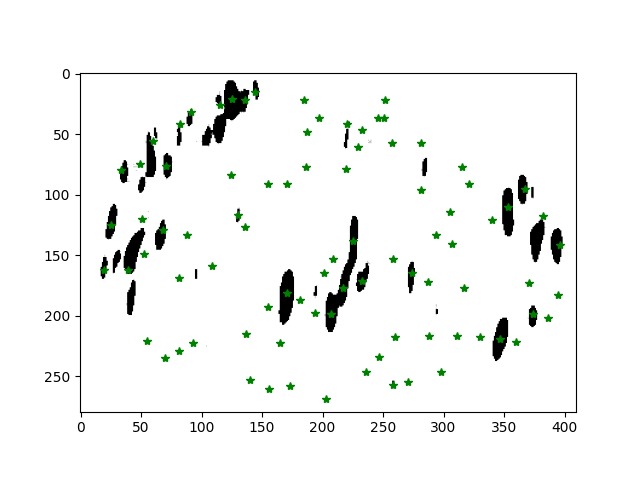

In [23]:
%matplotlib notebook


abs_im = (np.abs(one_trial_pca_walk_rest_flat) > np.quantile(np.abs(one_trial_pca_walk_rest_flat),0.95)).astype(np.int)
abs_im2 = binary_opening(abs_im, selem=np.ones((3,2)))
abs_im2 = binary_closing(abs_im2, selem=np.ones((3,2)))
plt.imshow(abs_im+2*abs_im2, 
           cmap=plt.cm.get_cmap("Greys"))
_ = [plt.plot(roi[1]-shape[2], roi[0]-shape[0], 'g*') for roi in roi_center]
# for i in range(len(roi_centers[i_fly])):
#     axs[0,0].annotate(str(i), np.flip(np.array(roi_center[i])-np.array(shape[::2])))

In [24]:
include_pixels = abs_im2.flatten()
print(sum(include_pixels))

5660


In [25]:
i_fly = 0
one_fly_walk_flat_selected = [trial_datas_walk[:,include_pixels] for trial_datas_walk in neural_datas_flat_walk]  # all_neurons_flat_datas_walk[i_fly]]
one_fly_rest_flat_selected = [trial_datas_rest[:,include_pixels] for trial_datas_rest in neural_datas_flat_rest]  # all_neurons_flat_datas_rest[i_fly]]
mean = np.mean(np.concatenate(one_fly_walk_flat_selected+one_fly_rest_flat_selected), axis=0)
std = np.std(np.concatenate(one_fly_walk_flat_selected+one_fly_rest_flat_selected), axis=0)

one_fly_walk_flat_selected = [(data - mean) / std for data in one_fly_walk_flat_selected]
one_fly_rest_flat_selected = [(data - mean) / std for data in one_fly_rest_flat_selected]

In [26]:
cov_total = an.cov(np.concatenate(one_fly_walk_flat_selected+one_fly_rest_flat_selected))
sort_idx = an.cluster_corr(cov_total)
one_fly_walk_flat_selected = [data[:, sort_idx] for data in one_fly_walk_flat_selected]
one_fly_rest_flat_selected = [data[:, sort_idx] for data in one_fly_rest_flat_selected]

In [28]:
cov_total = an.cov(np.concatenate(one_fly_walk_flat_selected+one_fly_rest_flat_selected))

<IPython.core.display.Javascript object>


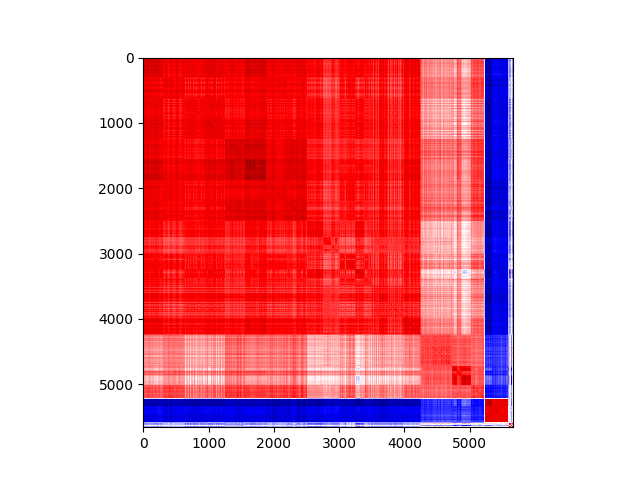

In [29]:
%matplotlib notebook
plt.imshow(cov_total, cmap=plt.cm.get_cmap("seismic"))

In [30]:
tmp = np.zeros_like(include_pixels).astype(np.float32)
tmp[include_pixels] = np.argsort(sort_idx) + 1
tmp[np.logical_not(include_pixels)] = None
tmp = tmp.reshape(size_y,-1)

<IPython.core.display.Javascript object>


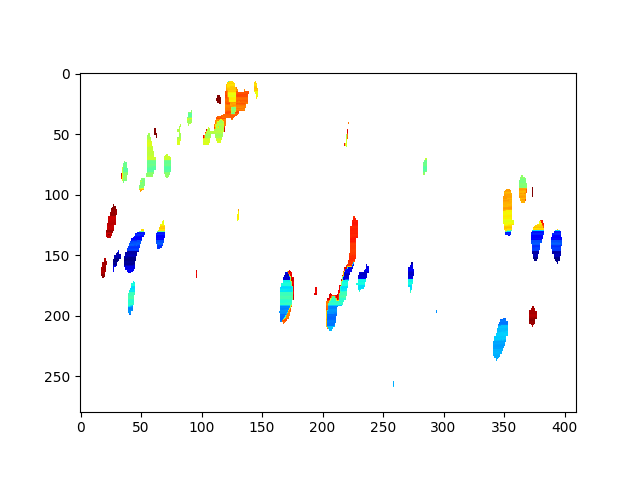

In [31]:
%matplotlib notebook
plt.imshow(tmp, cmap=plt.cm.get_cmap("jet"), clim=[1,5626])

In [32]:
cov_X, cov_X_walk, cov_X_rest, cov_X_intra, cov_X_inter = an.cov_pair(np.concatenate(one_fly_walk_flat_selected), 
                                                                      np.concatenate(one_fly_rest_flat_selected))

<IPython.core.display.Javascript object>


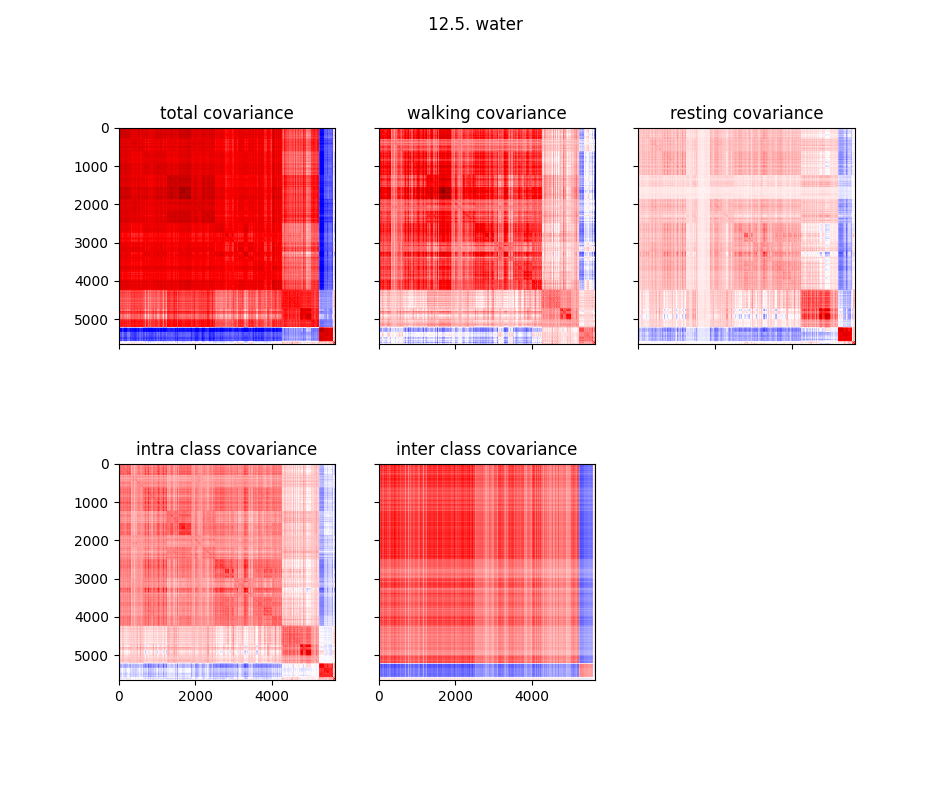

Text(0.5, 0.98, '12.5. water')

In [33]:
%matplotlib notebook
fig, axs = plt.subplots(2,3,figsize=(9.5, 8), sharex=True, sharey=True)
clim = [np.quantile(cov_X, 0.01), np.quantile(cov_X, 0.99)]
clim = [-1,1]
axs[0,0].imshow(cov_X, clim=clim, cmap=plt.cm.get_cmap("seismic"))
axs[0,0].set_title("total covariance")
axs[0,1].imshow(cov_X_walk, clim=clim, cmap=plt.cm.get_cmap("seismic"))
axs[0,1].set_title("walking covariance")
axs[0,2].imshow(cov_X_rest, clim=clim, cmap=plt.cm.get_cmap("seismic"))
axs[0,2].set_title("resting covariance")
axs[1,0].imshow(cov_X_intra, clim=clim, cmap=plt.cm.get_cmap("seismic"))
axs[1,0].set_title("intra class covariance")
axs[1,1].imshow(cov_X_inter, clim=clim, cmap=plt.cm.get_cmap("seismic"))
axs[1,1].set_title("inter class covariance")
axs[1,2].axis("off")
fig.suptitle(conditions[i_fly])

In [34]:
w_inter_pca = an.inter_condition_pca(np.concatenate(one_fly_walk_flat_selected), np.concatenate(one_fly_rest_flat_selected)) 

In [142]:
# w_inter_lda = an.inter_condition_lda(np.concatenate(one_fly_walk_flat_selected), np.concatenate(one_fly_rest_flat_selected)) 
# w_pca = an.pca(np.concatenate(one_fly_walk_flat_selected+one_fly_rest_flat_selected), n=1).squeeze()

In [35]:
X_proj_walk_inter_pca = np.concatenate(one_fly_walk_flat_selected).dot(w_inter_pca) 
X_proj_rest_inter_pca = np.concatenate(one_fly_rest_flat_selected).dot(w_inter_pca) 
# X_proj_walk_inter_lda = np.concatenate(one_fly_walk_flat_selected).dot(w_inter_lda) 
# X_proj_rest_inter_lda = np.concatenate(one_fly_rest_flat_selected).dot(w_inter_lda) 


<IPython.core.display.Javascript object>


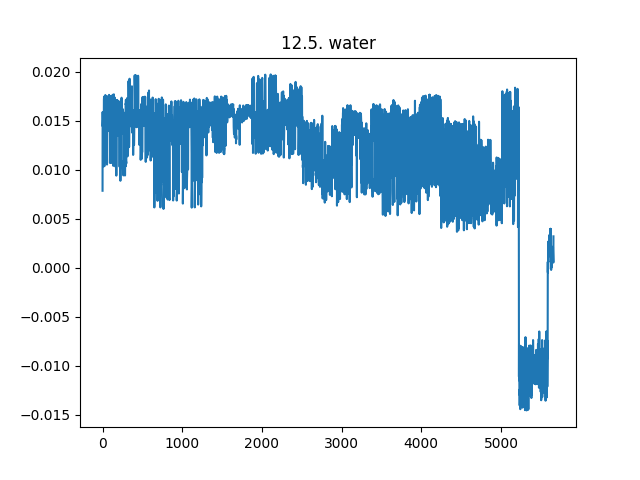

Text(0.5, 1.0, '12.5. water')

In [36]:
%matplotlib notebook
fig, ax = plt.subplots(1,1)

ax.plot(w_inter_pca, label="inter condition pca")  # , alpha=0.1)
# ax.plot(w_inter_lda, label="inter condition lda", alpha=0.1)
ax.set_title(conditions[i_fly])

In [37]:
tmp = np.zeros_like(include_pixels).astype(np.float32)
tmp[include_pixels] = w_inter_pca[np.argsort(sort_idx)]
tmp[np.logical_not(include_pixels)] = None
tmp = tmp.reshape(size_y,-1)

<IPython.core.display.Javascript object>


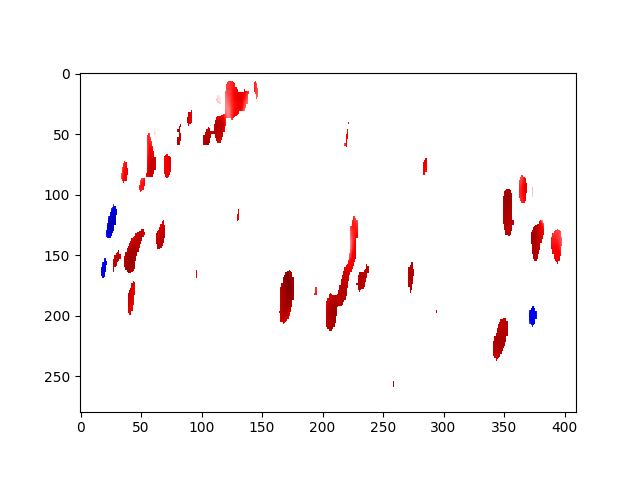

In [38]:
%matplotlib notebook
plt.imshow(tmp, cmap=plt.cm.get_cmap("seismic"), clim=[-0.02, 0.02])

<IPython.core.display.Javascript object>


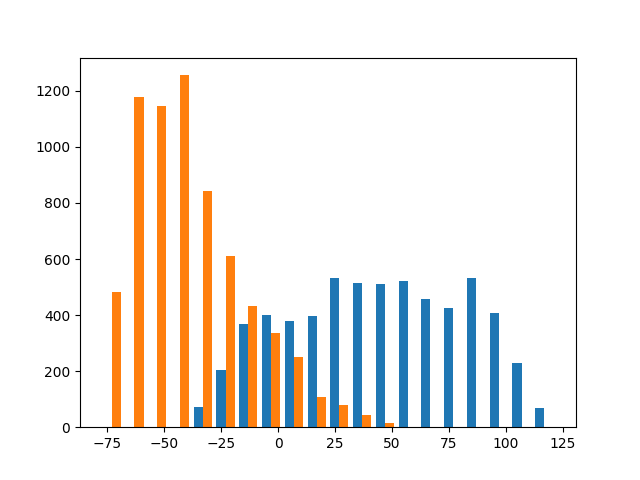

(array([[   0.,    0.,    0.,    2.,   71.,  203.,  368.,  402.,  379.,
          396.,  533.,  514.,  510.,  523.,  459.,  427.,  532.,  408.,
          230.,   68.],
        [ 481., 1179., 1145., 1256.,  842.,  612.,  434.,  337.,  250.,
          108.,   78.,   43.,   15.,    0.,    0.,    0.,    0.,    0.,
            0.,    0.]]),
 array([-78.16248  , -68.15762  , -58.152756 , -48.147892 , -38.14303  ,
        -28.138165 , -18.1333   ,  -8.128437 ,   1.8764267,  11.88129  ,
         21.886154 ,  31.891018 ,  41.89588  ,  51.900745 ,  61.90561  ,
         71.91048  ,  81.91534  ,  91.9202   , 101.925064 , 111.92993  ,
        121.93479  ], dtype=float32),
 <a list of 2 BarContainer objects>)

In [39]:
%matplotlib notebook

plt.hist([X_proj_walk_inter_pca, X_proj_rest_inter_pca], bins=20)

In [53]:
cov_matrix_walk, cov_total_walk, cov_intra_walk, cov_inter_walk = an.all_cov_pairs(one_fly_walk_flat_selected)
cov_matrix_rest, cov_total_rest, cov_intra_rest, cov_inter_rest = an.all_cov_pairs(one_fly_rest_flat_selected)

<IPython.core.display.Javascript object>


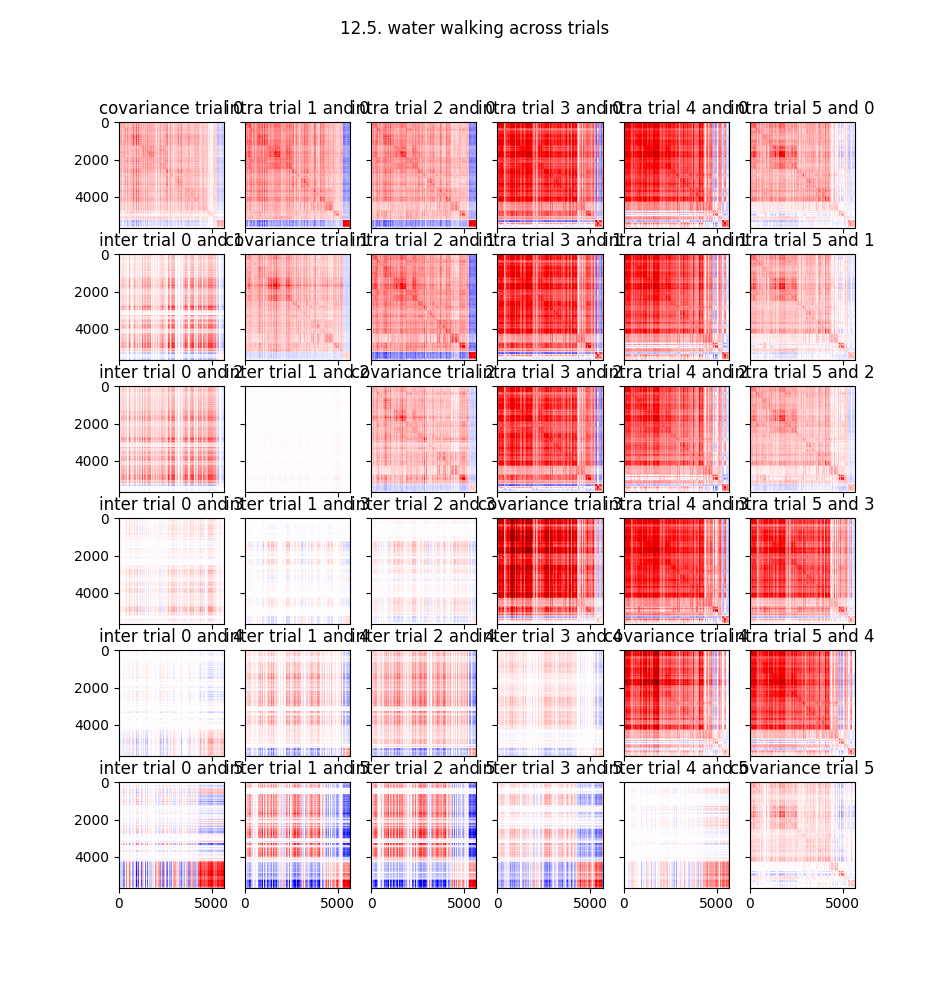

In [54]:
%matplotlib notebook
an.plot_cov_matrix(cov_matrix_walk, trials=[0,1,2,3,4,5], clim=[-1,1], name=conditions[i_fly]+" walking across trials")

<IPython.core.display.Javascript object>


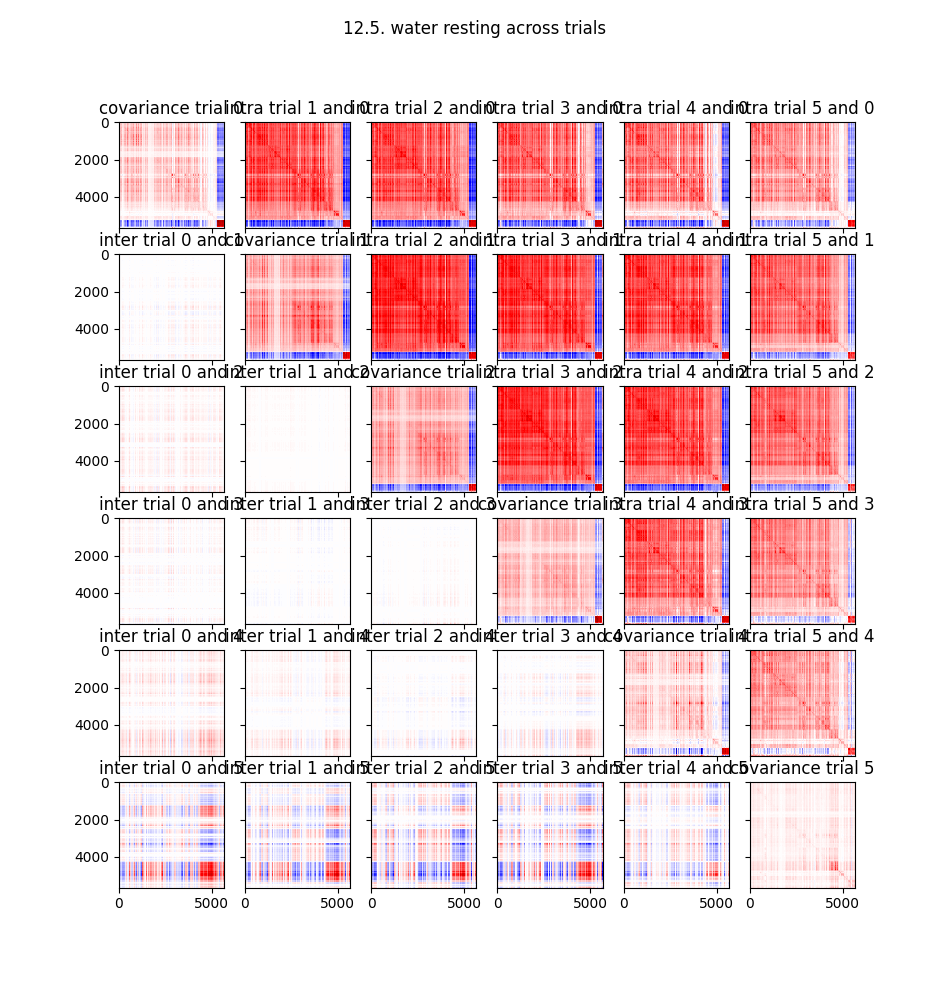

In [56]:
%matplotlib notebook
an.plot_cov_matrix(cov_matrix_rest, trials=[0,1,2,3,4,5], clim=[-1,1], name=conditions[i_fly]+" resting across trials")

In [40]:
norm = True
return_norm = True

w_inter_pca_walk, w_inter_lda_walk, w_pca_walk, norm_pca_walk, norm_lda_walk = an.all_inter_condition_pairs(one_fly_walk_flat_selected, 
                                                                                  norm=norm, return_norm=return_norm, use_pca=False)

w_inter_pca_rest, w_inter_lda_rest, w_pca_rest, norm_pca_rest, norm_lda_rest = an.all_inter_condition_pairs(one_fly_rest_flat_selected, 
                                                                                  norm=norm, return_norm=return_norm, use_pca=False)

In [65]:
print(norm_pca_walk)
print(norm_pca_rest)

[[ 0.         57.37720108 63.73062134 45.31527328 38.40477371 67.02713776]
 [ 0.          0.         14.7590847  40.59556198 59.86641693 72.14810181]
 [ 0.          0.          0.         40.25395966 62.20307159 71.15352631]
 [ 0.          0.          0.          0.         38.09739304 59.12482452]
 [ 0.          0.          0.          0.          0.         41.76853561]
 [ 0.          0.          0.          0.          0.          0.        ]]
[[ 0.         19.70730782 23.0316391  19.2295208  27.12257576 51.28660965]
 [ 0.          0.         10.9619627  17.96355057 24.71310043 50.55120087]
 [ 0.          0.          0.         17.9703083  23.42882919 51.86590958]
 [ 0.          0.          0.          0.         23.32298851 53.86326599]
 [ 0.          0.          0.          0.          0.         43.36980438]
 [ 0.          0.          0.          0.          0.          0.        ]]


<IPython.core.display.Javascript object>


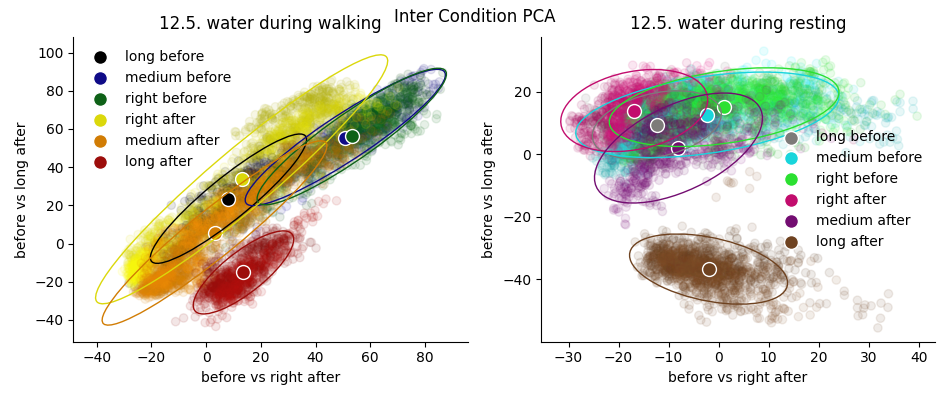

Text(0.5, 0.98, 'Inter Condition PCA')

In [59]:
%matplotlib notebook

colors = [myplt.BLACK, myplt.DARKBLUE, myplt.DARKGREEN, myplt.DARKYELLOW, myplt.DARKORANGE, myplt.DARKRED]  # myplt.BLACK, 
colors_contrast = [myplt.DARKGRAY, myplt.DARKBLUE_CONTRAST, myplt.DARKGREEN_CONTRAST, myplt.DARKPINK, myplt.DARKPURPLE, myplt.DARKBROWN]
# colors = [myplt.DARKBLUE, myplt.DARKYELLOW, myplt.DARKRED]
# colors_contrast = [myplt.DARKBLUE_CONTRAST,myplt.DARKPINK, myplt.DARKBROWN]

trials = [0,1,2,3,4,5]
colors = [colors[t] for t in trials]
colors_contrast = [colors_contrast[t] for t in trials]
X_names = ["long before", "medium before", "right before", "right after", "medium after", "long after"]
X_names = [X_names[t] for t in trials]

fig, axs = plt.subplots(1,2, figsize=(9.5,4))
an.plot_proj_scatter(w_1=w_inter_pca_walk[2,3], w_2=w_inter_pca_walk[2,5],
             X_trials=one_fly_walk_flat_selected, trials=trials, w_names=["before vs right after", "before vs long after"],
             X_names=X_names, 
             fig=fig, ax=axs[0], alpha=0.1, name=conditions[i_fly]+" during walking",colors=colors, gradual=True)
an.plot_proj_scatter(w_1=w_inter_pca_rest[2,3], w_2=w_inter_pca_rest[2,5],
             X_trials=one_fly_rest_flat_selected, trials=trials, w_names=["before vs right after", "before vs long after"],
             X_names=X_names, 
             fig=fig, ax=axs[1], alpha=0.1, name=conditions[i_fly]+" during resting",colors=colors_contrast, gradual=True)
fig.suptitle("Inter Condition PCA")

<IPython.core.display.Javascript object>


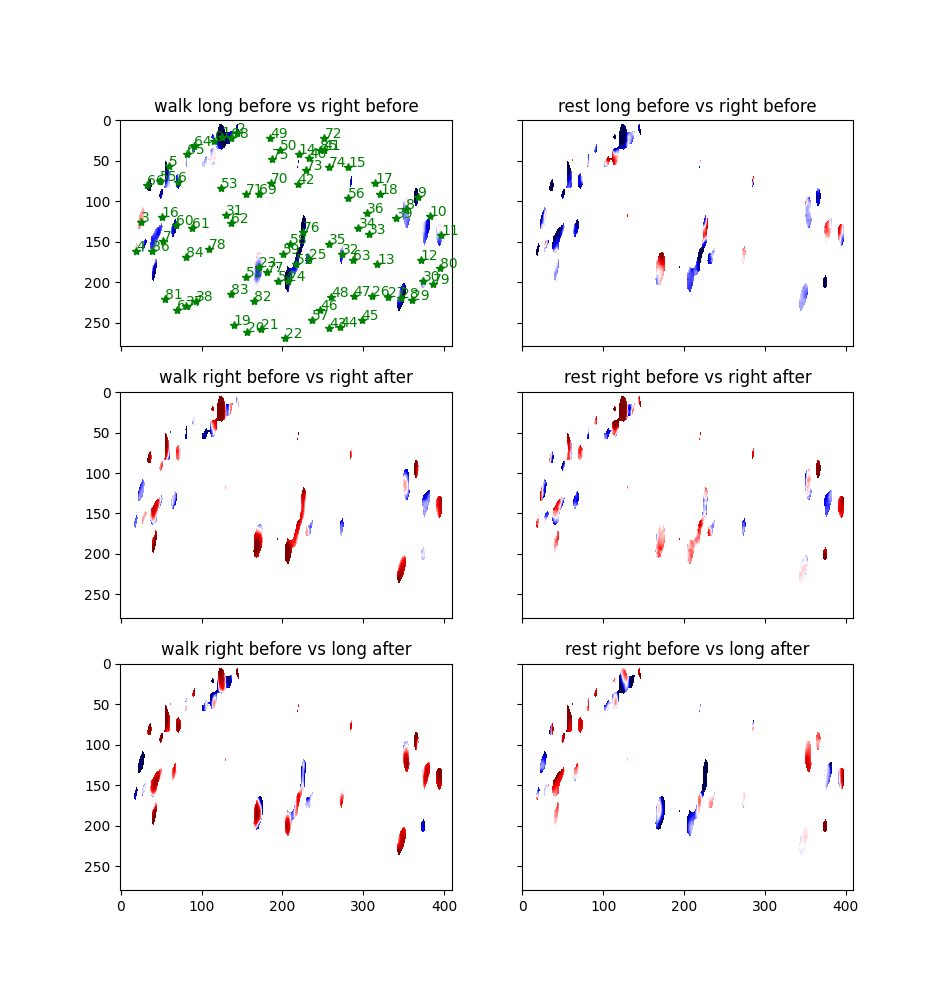

In [96]:
%matplotlib notebook

cols = [w_inter_pca_walk, w_inter_pca_rest]
col_names = ["walk", "rest"]
rows = [[0,2], [2,3], [2,5]]
row_names = ["long before vs right before", "right before vs right after", "right before vs long after"]

fig, axs = plt.subplots(3,2, figsize=(9.5, 10), sharex=True, sharey=True)
for i_row, axs_ in enumerate(axs):
    for i_col, ax in enumerate(axs_):
        tmp = np.zeros_like(include_pixels).astype(np.float32)
        tmp[include_pixels] = cols[i_col][rows[i_row][0],rows[i_row][1]][np.argsort(sort_idx)]
        tmp[np.logical_not(include_pixels)] = None
        tmp = tmp.reshape(size_y,-1)
        ax.imshow(tmp, cmap=plt.cm.get_cmap("seismic"), clim=[-0.02, 0.02])
        ax.set_title(col_names[i_col]+" "+row_names[i_row])
        
_ = [axs[0,0].plot(roi[1]-shape[2], roi[0]-shape[0], 'g*') for roi in roi_center]
for i in range(len(roi_center)):
    axs[0,0].annotate(str(i), np.flip(np.array(roi_center[i])-np.array(shape[::2])), color="green")

interesting ROIs: <br>
- 30: bottom right resting neuron becomes walking neuron in last trial
- 3&4: bottom left resting
- 1: top left
- 76: center
- 9: right
- 23, 24: bottom center

In [98]:
from scipy.ndimage import gaussian_filter1d

<IPython.core.display.Javascript object>


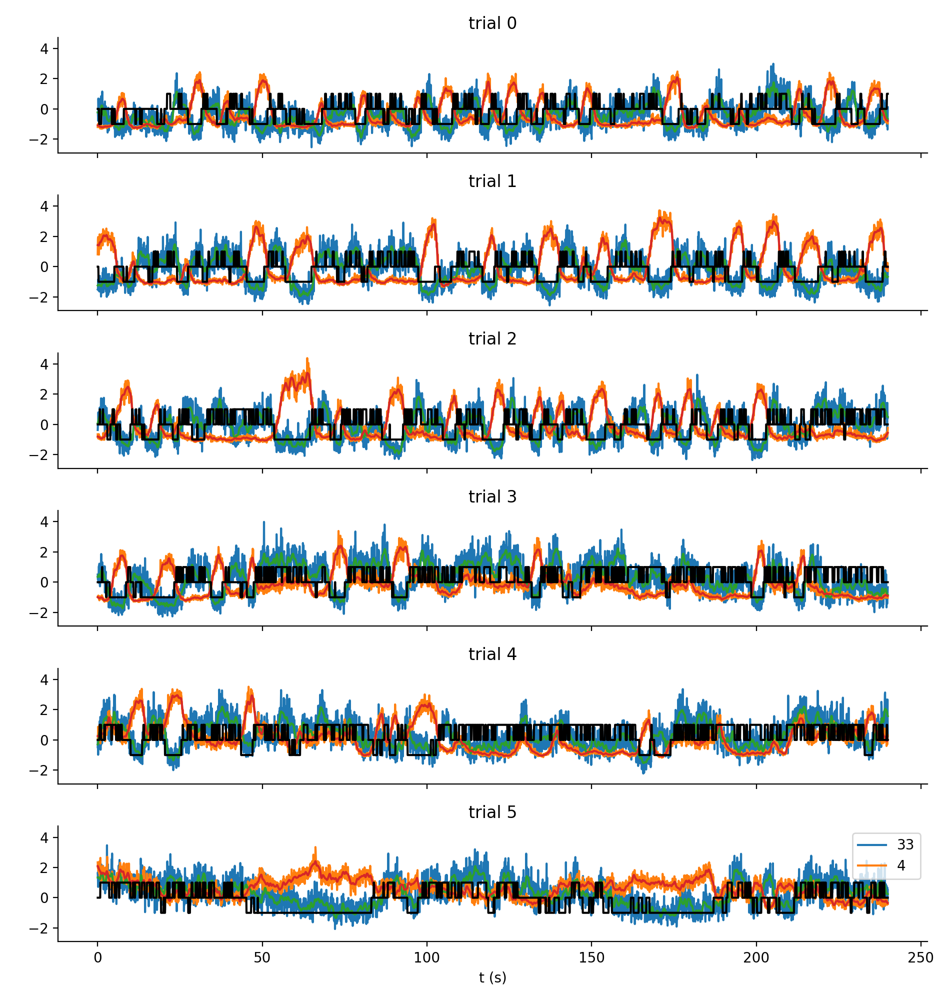

In [104]:
%matplotlib notebook
i_fly = 0
i_rois_orig = [33,4]  # [3,4]  
# i_rois_sorted = [np.argwhere(sort_idx[i_fly]==i_roi)[0,0] for i_roi in i_rois_orig]
this_neurons_trials = [neural_dfs[i_trial].filter(regex="neuron").values[:, i_rois_orig]for i_trial in range(6)]
mean = np.mean(np.concatenate(this_neurons_trials), axis=0)
std = np.std(np.concatenate(this_neurons_trials), axis=0)
this_neurons_trials = [(this_trial - mean) / std for this_trial in this_neurons_trials]

this_rest = np.array(rest_strict_reds).astype(np.int32)
this_walk = np.array(walk_strict_reds).astype(np.int32)
fig, axs = plt.subplots(6,1, figsize=(9.5, 10), sharex=True, sharey=True)
for i_trial, ax in enumerate(axs):
        ax.plot(np.arange(3840)/16, this_neurons_trials[i_trial], label=i_rois_orig)
        ax.plot(np.arange(3840)/16, gaussian_filter1d(this_neurons_trials[i_trial], sigma=3, axis=0))
        ax.plot(np.arange(3840)/16, this_walk[i_trial]-this_rest[i_trial], 'k')
        ax.set_title("trial {}".format(i_trial))
        if i_trial == 5:
            ax.set_xlabel("t (s)")
            ax.legend()
        ax.spines["top"].set_visible(False)
        ax.spines["right"].set_visible(False)
fig.tight_layout()

In [101]:
this_neurons_trials[i_trial].shape

(3840, 1)